<a href="https://colab.research.google.com/github/parhamvz73/Machine-Learning/blob/main/Santander_Customer_Transaction_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Step 1: Setup and Installations

## Essential installations

we keep all installations and tools and libraries here to make sure code is readable and transparent for other readers

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math
import matplotlib.image as mpimg
import sys
import tensorflow as tf

## Python version

checking the python version we are using in the notebook

In [2]:
print(sys.version)

3.12.11 (main, Jun  4 2025, 08:56:18) [GCC 11.4.0]


## Current device CPU vs GPU

In [3]:
device_name =tf.test.gpu_device_name()
if device_name :
  print(f"You are using GPU called: {device_name}")
else :
  print(" Your notebook is running on CPU")

 Your notebook is running on CPU


## Importing our data set

we build a local function for importing and showing some data about our data set

In [4]:
def read_csv(path = str):
     """
     this function will get the path as string and print sucess message
     with info and shape and head 10 for the csv file

     Parameters:
     ----
     path : str
       path to the csv file
     """
     try:
       dataframe= pd.read_csv(path)
       print(f"our data set is successfully imported from path: {path}\n")
       print(f"our data set has the shape of: \n")
       print(dataframe.shape)
       print(f"our data set has also the info as: \n")
       print(dataframe.info())
       print(f"10 first rows in our data set are: \n")
       print(dataframe.head(10))
       return dataframe
     except Exception as e:
       print(f"file couldnt be imported due to error: {e}\n")
       return None

In [5]:
df = read_csv("/content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data/train.csv")

our data set is successfully imported from path: /content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data/train.csv

our data set has the shape of: 

(200000, 202)
our data set has also the info as: 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 202 entries, ID_code to var_199
dtypes: float64(200), int64(1), object(1)
memory usage: 308.2+ MB
None
10 first rows in our data set are: 

   ID_code  target    var_0   var_1    var_2   var_3    var_4    var_5  \
0  train_0       0   8.9255 -6.7863  11.9081  5.0930  11.4607  -9.2834   
1  train_1       0  11.5006 -4.1473  13.8588  5.3890  12.3622   7.0433   
2  train_2       0   8.6093 -2.7457  12.0805  7.8928  10.5825  -9.0837   
3  train_3       0  11.0604 -2.1518   8.9522  7.1957  12.5846  -1.8361   
4  train_4       0   9.8369 -1.4834  12.8746  6.6375  12.2772   2.4486   
5  train_5       0  11.4763 -2.3182  12.6080  8.6264  10.9621   3.5609   
6  train_6       0  11.8091 -

In [6]:
df.head(10)

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104
5,train_5,0,11.4763,-2.3182,12.6080,8.6264,10.9621,3.5609,4.5322,15.2255,...,-6.3068,6.6025,5.2912,0.4403,14.9452,1.0314,-3.6241,9.7670,12.5809,-4.7602
6,train_6,0,11.8091,-0.0832,9.3494,4.2916,11.1355,-8.0198,6.1961,12.0771,...,8.7830,6.4521,3.5325,0.1777,18.3314,0.5845,9.1104,9.1143,10.8869,-3.2097
7,train_7,0,13.5580,-7.9881,13.8776,7.5985,8.6543,0.8310,5.6890,22.3262,...,13.1700,6.5491,3.9906,5.8061,23.1407,-0.3776,4.2178,9.4237,8.6624,3.4806
8,train_8,0,16.1071,2.4426,13.9307,5.6327,8.8014,6.1630,4.4514,10.1854,...,1.4298,14.7510,1.6395,1.4181,14.8370,-1.9940,-1.0733,8.1975,19.5114,4.8453
9,train_9,0,12.5088,1.9743,8.8960,5.4508,13.6043,-16.2859,6.0637,16.8410,...,0.5543,6.3160,1.0371,3.6885,14.8344,0.4467,14.1287,7.9133,16.2375,14.2514


In [7]:
df.tail(10)

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
199990,train_199990,1,14.1475,1.8568,11.0066,3.6779,12.1944,-16.5936,5.3217,14.8508,...,-6.4708,4.7287,1.9034,7.2324,20.6047,1.7170,-4.0032,9.1627,13.8077,-1.9646
199991,train_199991,0,9.9909,2.5523,11.9653,6.3958,13.5497,-9.5293,6.0864,14.1789,...,12.0737,5.2139,0.8094,-0.6585,17.0548,0.5328,-5.3444,8.5414,13.2895,-6.7896
199992,train_199992,0,12.2825,2.6918,15.4684,6.4262,10.9863,9.9659,4.5030,9.9232,...,3.9514,10.9040,1.3472,5.6184,20.5498,-0.2854,7.6252,10.1758,17.4066,-11.5244
199993,train_199993,0,13.2152,-5.8006,9.7260,6.5910,12.4612,-7.1652,6.0666,12.9887,...,3.9357,8.8442,1.8096,-4.8314,22.0050,0.3916,6.7302,8.9709,14.5405,6.1149
199994,train_199994,0,12.3925,-5.8821,11.2323,3.9237,10.4509,10.7262,7.0503,18.6968,...,1.3911,6.8687,3.7788,6.3378,14.4656,-1.4843,-3.9299,9.1164,16.3170,-7.5048
199995,train_199995,0,11.4880,-0.4956,8.2622,3.5142,10.3404,11.6081,5.6709,15.1516,...,6.1415,13.2305,3.9901,0.9388,18.0249,-1.7939,2.1661,8.5326,16.6660,-17.8661
199996,train_199996,0,4.9149,-2.4484,16.7052,6.6345,8.3096,-10.5628,5.8802,21.5940,...,4.9611,4.6549,0.6998,1.8341,22.2717,1.7337,-2.1651,6.7419,15.9054,0.3388
199997,train_199997,0,11.2232,-5.0518,10.5127,5.6456,9.3410,-5.4086,4.5555,21.5571,...,4.0651,5.4414,3.1032,4.8793,23.5311,-1.5736,1.2832,8.7155,13.8329,4.1995
199998,train_199998,0,9.7148,-8.6098,13.6104,5.7930,12.5173,0.5339,6.0479,17.0152,...,2.6840,8.6587,2.7337,11.1178,20.4158,-0.0786,6.7980,10.0342,15.5289,-13.9001
199999,train_199999,0,10.8762,-5.7105,12.1183,8.0328,11.5577,0.3488,5.2839,15.2058,...,8.9842,1.6893,0.1276,0.3766,15.2101,-2.4907,-2.2342,8.1857,12.1284,0.1385


In [8]:
df.iloc[1000:1020]

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
1000,train_1000,0,8.5826,-8.3369,10.1053,10.2773,12.3695,-0.5861,4.6452,21.4091,...,2.0163,9.2570,0.9863,3.7194,13.8578,0.8077,10.1349,9.7018,17.7495,-9.2302
1001,train_1001,0,13.7080,-10.4985,9.1846,5.6701,12.7300,-5.8418,3.9331,18.3771,...,-3.4061,9.8111,2.8511,2.7865,19.5933,-0.4843,6.8172,8.4074,13.9751,-7.1172
1002,train_1002,0,12.9621,0.7124,8.5301,8.3386,10.9782,3.0556,4.7670,23.1598,...,-2.5976,6.0758,1.9013,0.6801,20.9411,-1.6281,-5.0993,10.1068,21.3219,-6.3615
1003,train_1003,0,13.6811,-2.4476,13.0882,8.3289,12.1988,-3.0825,7.1168,14.1075,...,11.3997,7.8981,1.6591,9.7205,22.8523,1.0557,-7.8208,10.8416,19.6183,-16.1505
1004,train_1004,1,12.0543,6.5180,10.9406,10.8711,13.8366,-9.1280,4.4166,23.3048,...,10.9114,7.5590,2.8588,4.9739,12.6122,-1.2884,6.5470,7.8977,14.1504,7.7103
1005,train_1005,0,10.1408,3.5415,7.9441,4.5350,10.6567,-0.1525,5.9156,15.4672,...,-2.5726,5.7680,0.5693,-0.5712,15.3370,-1.5580,-5.7485,9.7814,16.4050,-3.0244
1006,train_1006,1,8.4771,2.6302,12.3540,6.5957,10.1070,2.7118,4.4813,12.9906,...,8.1706,9.7307,1.7466,-0.6826,19.8558,-1.1447,6.3399,8.7369,15.4435,13.9467
1007,train_1007,0,5.4274,6.7085,9.7421,9.4354,9.9631,-1.9593,6.0064,18.8581,...,3.2181,5.1163,1.7715,3.0367,16.0555,-2.5182,7.0669,6.7900,20.3073,3.1341
1008,train_1008,0,11.0784,0.1405,12.8151,9.5038,9.4068,-15.4522,4.0931,21.6229,...,9.9014,9.7926,1.1227,11.5060,16.7937,0.7824,9.6276,9.1515,20.7109,-6.4175
1009,train_1009,0,11.6629,-8.4512,11.0571,6.3849,13.0875,6.8549,4.7925,17.8546,...,-1.5133,6.7310,-0.4033,0.8032,15.1653,-1.8017,9.4642,9.1741,15.9036,6.5791


In [9]:
df.dtypes

,0
ID_code,object
target,int64
var_0,float64
var_1,float64
var_2,float64
...,...
var_195,float64
var_196,float64
var_197,float64
var_198,float64


## Checklist for Step 1

- ✅ Installed required libraries so far and dependencies (numpy, pandas, tensorflow for device detection, ...)
- ✅ Verified python version we will use through out this Projects ( we are using python 3.12.11)
- ✅ Checked the device we are using  (CPU)
- ✅ Imported csv file as df
- ✅ Performed a quick check on train data info and head and tail and iloc

# Step 2: Project overview

## Project briefing

**Project Title:**

Santander Customer Transaction Prediction

---
**My enhanced Title:**
Predicting if a customer will make a transaction or not (**Binary Classification**)

---
**Where is this data set coming from:**

Kaggle https://www.kaggle.com/competitions/santander-customer-transaction-prediction/overview

---

** Why this data set matters:**

It matters because it a real world problem for bussinesses to know and identify solution for common global challenges like is customer satisfied? will a customer buy this product?
can customer pay this loan

---
** Goal of this problem:**

build a predictive model that answers the question: “Who will make a transaction” using numeric feature variables (var_0, var_1, var_2 , etc).

---
** Evaluation metric:**

Submissions are evaluated on [area under the ROC curve](https://en.wikipedia.org/wiki/Receiver_operating_characteristic) between the predicted probability and the observed target.

---
** Submission format:**

| ID_code | target |
|---------|--------|
| test_0  |   0    |
| test_1  |   1    |
| test_2  |   0    |



## Project dictionary

Our training data set contains 202 columns and 200000 rows containing:
- `target` (binary) made a transaction or not which is integer
- `ID code` which is identification and object
- 200 columns `var` which are our anonymized features which are float

## Checklist for step 1

- ✅ Defined project title
- ✅ Defined project definitaion
- ✅ Wrote problem statement
- ✅ Identified target variable
- ✅ Selected evaluation mentrics based on the problem type

# Step 3: Exploritory data analysis `EDA`

## non or missing values

In [10]:
df.isna().sum().sort_values(ascending=False)

,0
ID_code,0
target,0
var_0,0
var_1,0
var_2,0
...,...
var_195,0
var_196,0
var_197,0
var_198,0


we dont have any na value

In [11]:
df.isnull().sum().sort_values(ascending=False)

,0
ID_code,0
target,0
var_0,0
var_1,0
var_2,0
...,...
var_195,0
var_196,0
var_197,0
var_198,0


we also dont have any null value

we will just create a plot to be sure we dont have any missing values

In [12]:
def plot_missing_values(dataset, title):
  fig, ax = plt.subplots(figsize=(25,5))
  plt.title(title)
  sns.heatmap(dataset.isnull(), cbar=True)

In [13]:
# plot_missing_values(df, "Training dataset missing values")
# we comment this out since we have a big data set and its taking long time to reproduce this plot again

In [14]:
def show_png(file_path: str, x, y):
    """
    Reads and displays a PNG (or other supported image) file.

    Parameters
    ----------
    file_path : str
        Path to the image file.
    x : int
        Width of the figure.
    y : int
        Height of the figure.
    """
    try:
        img = mpimg.imread(file_path)   # read image
        plt.figure(figsize=(x, y))      # adjust size if needed
        plt.imshow(img)                 # show image
        plt.axis("off")                 # hide axes for clean view
        plt.show()
    except Exception as e:
        print(f"❌ Error reading file: {e}")

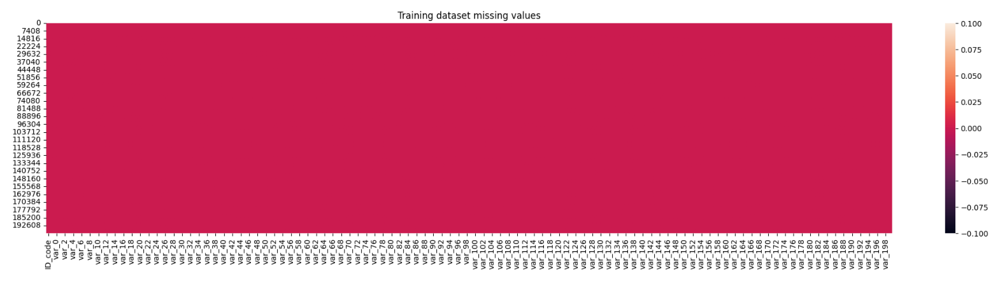

In [15]:
show_png("/content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data/missing values plot.png",20,12)

## checking balance level of target

In [16]:
df["target"].value_counts()

,count
target,
0,179902
1,20098


In [17]:
def plot_uni_countplot(feature, data):
  ax = sns.countplot(x=data[feature], data=data, color='darkviolet')
  plt.title(f"Countplot of {feature}")
  total = len(data)
  for p in ax.patches:
    percentage = f'{100 * p.get_height() / total:.1f}%\n'
    x = p.get_x() + p.get_width() /2
    y = p.get_height()
    ax.annotate(percentage, (x, y), ha='center', va='center')
  plt.tight_layout()
  plt.show()

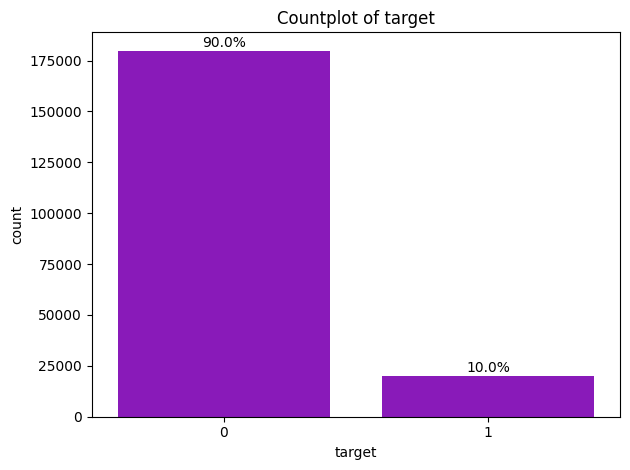

In [18]:
plot_uni_countplot(feature="target", data=df)

our target column is so imbalance with 9 to 1 ratio from no transaction being `0` to transaction made `1`

we need to balance our target column later, for now we look at ou each feture to see how balance or imbalance they are and check their mean and range and skew

## Cheking features being normal and standard

In [19]:
def plot_uni_histogram (df, bins=30):
    """
    Plots histograms for each numerical column in a DataFrame using subplots,
    including mean, median, and mode lines.

    Parameters:
    -----------
    num_df : pandas.DataFrame
        DataFrame with only numerical columns
    bins : int
        Number of bins for histograms (default=30)
    """
    num_df = df.select_dtypes(include=['float64', 'int64'])
    if num_df.empty:
        print("we couldnt find any numeric features in the data set")
        return
    n_cols = num_df.shape[1]
    n_rows = math.ceil(n_cols / 3)

    plt.figure(figsize=(18,5 *n_rows))

    for i, col in enumerate(num_df.columns,1):
        data = num_df[col].dropna()
        if data.empty:
            continue

        mean_val = data.mean()
        median_val = data.median()
        mode_val = data.mode()

        plt.subplot(n_rows, 3, i)
        sns.histplot(data, bins=bins , kde=True, color = 'violet', edgecolor='black')

        plt.axvline(mean_val, color='red', linestyle='dashed', linewidth=2, label=f'Mean: {mean_val:.2f}')
        plt.axvline(median_val, color='green', linestyle='dashed', linewidth=2, label=f'Median: {median_val:.2f}')
        if not mode_val.empty:
            if len(mode_val) > 1:
                plt.axvline(mode_val.iloc[0], color='blue', linestyle='dashed', linewidth=2, label=f'Mode: {mode_val.iloc[0]:.2f} (Multiple Modes)')
            else:
                plt.axvline(mode_val.iloc[0], color='blue', linestyle='dashed', linewidth=2, label=f'Mode: {mode_val.iloc[0]:.2f}')

        plt.title(f"Histogram of {col}", fontsize = 14, fontweight = "bold")
        plt.xlabel(col, fontsize=12)
        plt.ylabel("Frequency", fontsize=12)
        plt.grid(True, linestyle="--", alpha = 0.5)
        plt.legend()

    plt.tight_layout()
    plt.show()

In [20]:
# plot_uni_histogram(df)
# we comment this out and show the outcome as png below since we have a big data set and its taking ages we reproduce this plot again

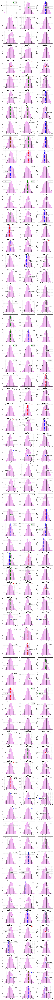

In [21]:
show_png("/content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data/uni hist plot numeric features.png", 20, 500)

almost all of our features look standard and normaly distributed
what we should do next are:
1. understanding each feature relation to target (how much they influence the target)
2. maybe we should also change their scale to a single scale since some of them have positive values but larger than the others and some of them also containig negative values
3. those features (since we have 200 features) which are not contributing that much to target maybe can be merged like negative ones with negative ones and positives with positivies

Perfect 👌 thanks for asking! Let’s break it down very simply, step by step, like I would explain to someone just starting in data science:

---

🔹 General Observations (simple meaning)

**1. Bell-shaped / Gaussian (Normal-like distribution)**

* Imagine exam scores in a big class: most people get an average grade, a few people get very high or very low.
* That “hill” shape is called a **normal distribution**.
* Your features look like that → so most values are near the middle (0), not too extreme.

---

**2. Standardized (mean ≈ 0, variance ≈ 1)**

* *Mean* = the average value.
* *Variance* = how spread out the data is.
* Standardized means:

  * Centered at 0 (average is 0).
  * Spread is around 1.
* This makes all features comparable, like putting everything on the same scale (meters, not some in cm and some in km).

---

**3. Symmetry**

* The left and right sides of the histogram look the same.
* Example: -5 and +5 appear about as often.
* This means the data isn’t “tilted” or skewed to one side.

---

**4. Outliers**

* Outliers = unusual values very far from the average.
* Example: in exam scores, if most got 50–90 but one person got 0, that’s an outlier.
* Your dataset has a few outliers, but not too many → not a big problem.

---

**5. Uniformity across features**

* All 202 features look similar in shape.
* This suggests they were carefully prepared (maybe by the dataset creators).
* Many Kaggle competition datasets are built this way to be “fair” for machine learning.

---

🔹 What This Means for You

**1. Scaling not needed**

* Normally, you use `StandardScaler` to put features on the same scale.
* But your features are already standardized → no need to scale again.

---

**2. Linear / Tree models**

* **Linear models** (like Logistic Regression) → they like standardized data, so they will work well here.
* **Tree models** (like RandomForest, XGBoost) → they don’t care about scaling. They split data based on rules (`x > 0.5?`).
* So both types of models are good choices.

---

**3. No strong skewness**

* **Skewed** means data is stretched to one side (like most exam scores being low and only a few high).
* Your data isn’t skewed → no need for log transformation.

---

**4. Feature redundancy**

* If two columns contain very similar information, they’re “redundant”.
* Example: one column = height in cm, another = height in meters. They’re basically the same thing.
* Too many redundant features can slow down models without helping.
* That’s why we check **correlations**.

---

🔹 Next Steps

**1. Check correlations**

* Correlation shows how similar two columns are.
* Value goes from -1 to +1.

  * +1 = move together perfectly.
  * -1 = move opposite.
  * 0 = no relation.
* If many columns are highly correlated, you can drop some.

---

**2. Dimensionality Reduction (PCA/UMAP)**

* You have 202 columns = high-dimensional.
* **PCA (Principal Component Analysis)**:

  * Finds new “summary” columns that keep most of the information but reduce size.
  * Example: compressing 202 columns into 20.
* **UMAP**: Another method, often used for visualization.

---

**3. Sampling**

* Your dataset has 20,000 rows.
* For plots/visualization, you don’t need all rows.
* You can take a small random sample (like 2,000 rows) to make plotting faster without losing the “big picture”.

---

**4. Model testing**

* Try a **simple model** first (like Logistic Regression).
* Then try a **stronger model** (like RandomForest).
* Compare accuracy. This helps you know what kind of models fit your dataset.

---

👉 In short:
Your dataset is already **clean and standardized**, so you can focus on **reducing dimensions, sampling for speed, and testing models**.

---

Do you want me to write you **a small Colab code example** that shows:

* how to check correlations,
* run PCA,
* and sample the data for faster plots?


In [22]:
pd.set_option('display.max_rows', None)
df_num = df.select_dtypes(include=['float64', 'int64'])
print("max values\n")
print(df_num.max())
print("min values\n")
print(df_num.min())
print("mean values\n")
print(df_num.mean())
print("median values\n")
print(df_num.median())
print("mode values\n")
print(df_num.mode())


max values

target      1.0000
var_0      20.3150
var_1      10.3768
var_2      19.3530
var_3      13.1883
var_4      16.6714
var_5      17.2516
var_6       8.4477
var_7      27.6918
var_8      10.1513
var_9      11.1506
var_10     18.6702
var_11     17.1887
var_12     14.6545
var_13     22.3315
var_14     14.9377
var_15     15.8633
var_16     17.9506
var_17     19.0259
var_18     41.7480
var_19     35.1830
var_20     31.2859
var_21     49.0443
var_22     14.5945
var_23      4.8752
var_24     25.4460
var_25     14.6546
var_26     15.6751
var_27      3.2431
var_28      8.7874
var_29     13.1431
var_30     15.6515
var_31     20.1719
var_32      6.7871
var_33     29.5466
var_34     13.2878
var_35     21.5289
var_36     14.2456
var_37     11.8638
var_38     29.8235
var_39     15.3223
var_40     18.1056
var_41     26.1658
var_42     13.4696
var_43     12.5779
var_44     34.1961
var_45     62.0844
var_46     21.2939
var_47     20.6854
var_48     54.2738
var_49     41.1530
var_50     15.3172


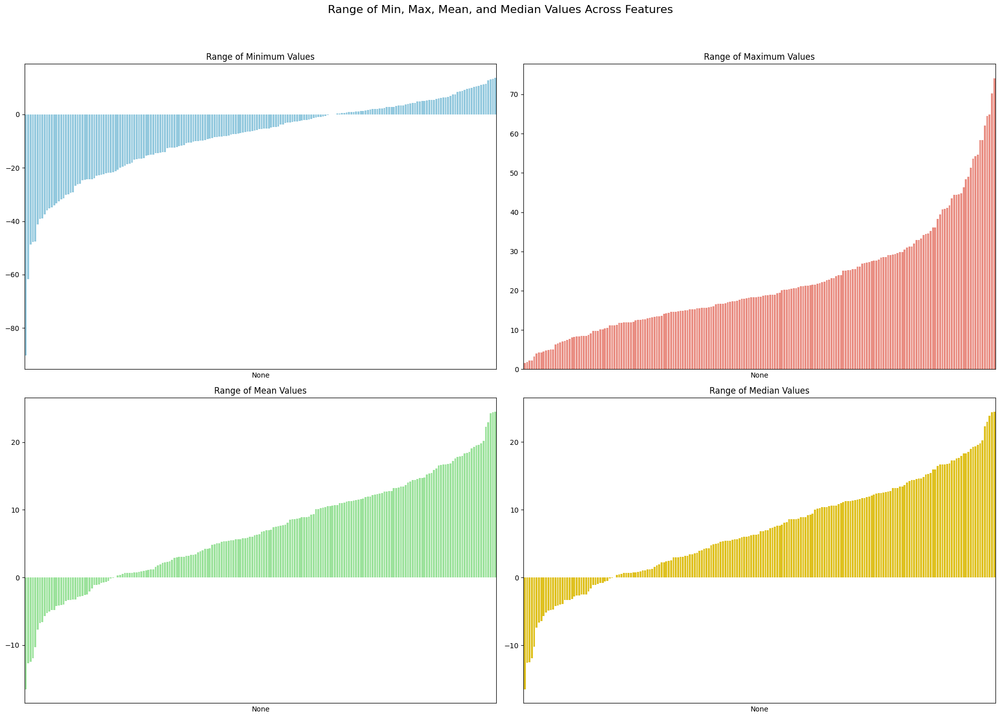

In [23]:
df_num = df.select_dtypes(include=['float64', 'int64']).drop(columns=['target'])

min_values = df_num.min().sort_values()
max_values = df_num.max().sort_values()
mean_values = df_num.mean().sort_values()
median_values = df_num.median().sort_values()

fig, axes = plt.subplots(2, 2, figsize=(20, 15))
fig.suptitle('Range of Min, Max, Mean, and Median Values Across Features', fontsize=16)

sns.barplot(x=min_values.index, y=min_values.values, ax=axes[0, 0], color='skyblue')
axes[0, 0].set_title('Range of Minimum Values')
axes[0, 0].tick_params(axis='x', rotation=90)
axes[0, 0].set_xticks([])

sns.barplot(x=max_values.index, y=max_values.values, ax=axes[0, 1], color='salmon')
axes[0, 1].set_title('Range of Maximum Values')
axes[0, 1].tick_params(axis='x', rotation=90)
axes[0, 1].set_xticks([])

sns.barplot(x=mean_values.index, y=mean_values.values, ax=axes[1, 0], color='lightgreen')
axes[1, 0].set_title('Range of Mean Values')
axes[1, 0].tick_params(axis='x', rotation=90)
axes[1, 0].set_xticks([])

sns.barplot(x=median_values.index, y=median_values.values, ax=axes[1, 1], color='gold')
axes[1, 1].set_title('Range of Median Values')
axes[1, 1].tick_params(axis='x', rotation=90)
axes[1, 1].set_xticks([])

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

🔹 Top-left: *Range of Minimum Values*

* Each bar = the smallest value in one feature.
* Some features go very low (around -80 to -90).
* Others have minimums near 0 or positive.
  👉 **Meaning**: Features don’t all start at the same level. Some have very negative outliers, others are mostly positive.

---

🔹 Top-right: *Range of Maximum Values*

* Each bar = the largest value in one feature.
* Some features have max only \~2–5, others go up to \~70+.
  👉 **Meaning**: Different features have very different upper ranges. Some columns contain very large positive values compared to others.

---

🔹 Bottom-left: *Range of Mean Values*

* Each bar = the average value of a feature.
* Most means are around 0, but some are clearly shifted (negative down to -15, positive up to \~20).
  👉 **Meaning**: Not all features are centered at 0. Some features systematically lean negative or positive.

---

🔹 Bottom-right: *Range of Median Values*

* Each bar = the middle value (50% above, 50% below).
* Very similar to the mean chart: most medians are near 0, but some are shifted left or right.
  👉 **Meaning**: Some features are slightly skewed (because their median ≠ mean), while many are balanced.

---

🧠 What We Can Learn Overall

1. **Not all features are perfectly standardized**

   * Some are shifted (mean/median not at 0).
   * Some have much bigger ranges (min/max far apart).

2. **There are outliers**

   * Large min/max gaps show extreme values exist in certain features.

3. **Feature diversity**

   * Even though histograms looked similar before (bell-shaped), this chart shows that some features are systematically *higher* or *lower* than others.

4. **Possible preprocessing needed**

   * If you want everything on the same scale, you might still consider re-standardizing (`StandardScaler`) or at least checking those shifted features.
   * You could also **clip outliers** if they distort models.




## Correlation between features and target

Top 10 features most positively correlated with target:


,0
var_6,0.066731
var_110,0.064275
var_53,0.063399
var_26,0.062422
var_22,0.060558
var_99,0.058367
var_190,0.055973
var_2,0.055870
var_133,0.054548
var_0,0.052390



Top 10 features most negatively correlated with target:


,0
var_165,-0.055734
var_80,-0.057609
var_166,-0.057773
var_21,-0.058483
var_174,-0.061669
var_76,-0.061917
var_146,-0.063644
var_12,-0.069489
var_139,-0.074080
var_81,-0.080917


/tmp/ipython-input-2056767307.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=correlations_with_target.values, y=correlations_with_target.index, palette='viridis')


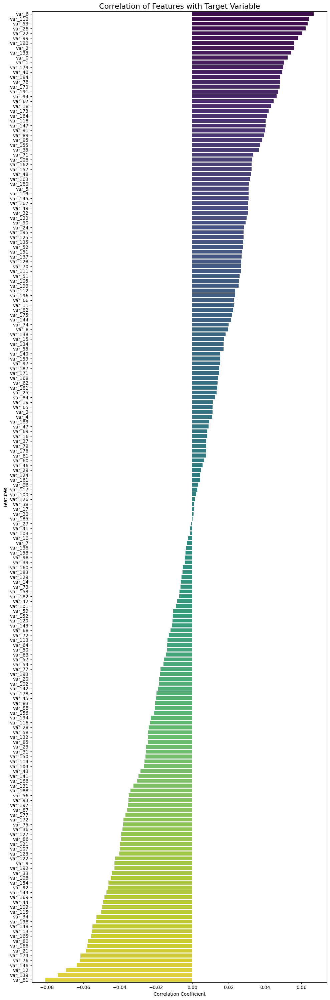

In [24]:
# Calculate correlations with the target variable
correlations_with_target = df_num.corrwith(df['target']).sort_values(ascending=False)

# Display the top and bottom correlations
print("Top 10 features most positively correlated with target:")
display(correlations_with_target.head(10))

print("\nTop 10 features most negatively correlated with target:")
display(correlations_with_target.tail(10))

# Optional: Visualize correlations with target (can be a bar plot if too many features)
plt.figure(figsize=(10, 30))
sns.barplot(x=correlations_with_target.values, y=correlations_with_target.index, palette='viridis')
plt.title('Correlation of Features with Target Variable', fontsize=16)
plt.xlabel('Correlation Coefficient')
plt.ylabel('Features')
plt.tight_layout()
plt.show()

🔹 What the chart shows

* The **x-axis** = correlation coefficient (number between -1 and +1).
* Each **bar** = one feature’s correlation with the target.
* **Blue bars** = positive correlation (higher feature values → more likely target = 1).
* **Red bars** = negative correlation (higher feature values → more likely target = 0).

---

🔹 Key Observations

1. **Correlation values are very small**

   * Most features are between **-0.08 and +0.07**.
   * That’s close to **0**, meaning no strong linear relationship with the target.
   * So: no single feature alone can easily predict the target.

2. **Some features are slightly more predictive**

   * Top features (like `var_6`, `var_110`, `var_53`) have the highest positive correlations (\~0.06–0.07).
   * Bottom features (like `var_81`, `var_139`, `var_146`) have the strongest negative correlations (\~-0.07 to -0.08).
   * These may be a little useful, but still weak on their own.

3. **Symmetry around 0**

   * Some features push the probability up (blue), others push it down (red).
   * This is expected in high-dimensional, engineered datasets (like Kaggle Santander).

4. **Multivariate power > single feature power**

   * Because correlations are so small, **single features don’t tell much**.
   * But combining many weak features can make a strong model (this is where ML models like XGBoost shine).

---

🔹 What This Means

* **Don’t rely on one feature** → You must use all (or many) features together.
* **Linear correlation isn’t everything** → Some features may have **non-linear** relationships with the target that this plot doesn’t capture.
* **Feature selection** → You might drop very weak ones (near zero correlation), but many ML algorithms (like tree models) can figure it out automatically.
* **Best models here** → Gradient boosting (XGBoost, LightGBM, CatBoost) often work well with datasets like this.

---

✅ **Simple takeaway:**
This dataset has **no strong single predictor**. Instead, it’s about combining **many weak signals** across 200+ features. That’s why tree-based ensemble models usually win on this type of data.

---

Would you like me to also explain **what correlation coefficient really means in super simple terms** (like an everyday analogy), so you can feel it intuitively?


## checking feature vs feature correlation

In [25]:
def get_top_bottom_correlations(df, n=20):
    """
    Calculates the correlation matrix for numerical features (excluding target)
    and returns the top N positive and top N negative feature-to-feature correlations.

    Parameters:
    -----------
    df : pandas.DataFrame
        The input DataFrame.
    n : int
        The number of top positive and negative correlations to return (default=20).

    Returns:
    --------
    tuple
        A tuple containing two DataFrames:
        - top_positive_correlations: DataFrame of the top N positive correlations.
        - top_negative_correlations: DataFrame of the top N negative correlations.
    """
    # Select only numerical features and exclude 'target'
    df_num = df.select_dtypes(include=[np.number]).drop(columns=['target'])

    # Calculate the correlation matrix
    corr_matrix = df_num.corr()

    # Remove self-correlations and duplicate pairs
    corr_matrix_unstacked = corr_matrix.stack().reset_index()
    corr_matrix_unstacked.columns = ['Feature1', 'Feature2', 'Correlation']
    corr_matrix_unstacked = corr_matrix_unstacked[corr_matrix_unstacked['Feature1'] != corr_matrix_unstacked['Feature2']]
    corr_matrix_unstacked['pair'] = corr_matrix_unstacked.apply(lambda row: tuple(sorted((row['Feature1'], row['Feature2']))), axis=1)
    corr_matrix_unstacked = corr_matrix_unstacked.drop_duplicates(subset=['pair']).drop('pair', axis=1)

    # Get top N positive and top N negative correlations
    top_positive_correlations = corr_matrix_unstacked.sort_values(by='Correlation', ascending=False).head(n)
    top_negative_correlations = corr_matrix_unstacked.sort_values(by='Correlation', ascending=True).head(n)

    return top_positive_correlations, top_negative_correlations

# Now call the function and display the results
top_pos_corr, top_neg_corr = get_top_bottom_correlations(df, n=20)

print("Top 20 Positive Feature Correlations:")
display(top_pos_corr)

print("\nTop 20 Negative Feature Correlations:")
display(top_neg_corr)

Top 20 Positive Feature Correlations:


,Feature1,Feature2,Correlation
16365,var_81,var_165,0.009714
16374,var_81,var_174,0.009490
36789,var_183,var_189,0.009359
29369,var_146,var_169,0.009071
24532,var_122,var_132,0.008956
16372,var_81,var_172,0.008936
2546,var_12,var_146,0.008591
34593,var_172,var_193,0.008163
1357,var_6,var_157,0.008076
33573,var_167,var_173,0.008045



Top 20 Negative Feature Correlations:


,Feature1,Feature2,Correlation
5339,var_26,var_139,-0.009844
10748,var_53,var_148,-0.009788
1280,var_6,var_80,-0.008958
280,var_1,var_80,-0.008855
413,var_2,var_13,-0.008795
16355,var_81,var_155,-0.008601
25562,var_127,var_162,-0.008555
10979,var_54,var_179,-0.008394
5272,var_26,var_72,-0.008062
6933,var_34,var_133,-0.008020


🔹 What the numbers mean

* Each row = a pair of features (e.g., `var_81` and `var_165`).
* The **correlation value** = how strongly they move together:

  * **+1** = perfect positive relation (when one goes up, the other always goes up).
  * **-1** = perfect negative relation (when one goes up, the other always goes down).
  * **0** = no relationship.
* Your values are **very close to 0** (between -0.009 and +0.009).

👉 That’s **extremely small** — almost no linear relationship between any two features.

---

🔹 Top 20 Positive Correlations

Example:

* `var_81` & `var_165` → 0.0097
* `var_81` & `var_174` → 0.0094
* `var_183` & `var_189` → 0.0093

✅ Even though these are the “top positive,” the correlations are still **basically zero**.
So, the features are **almost independent** of each other.

---

🔹 Top 20 Negative Correlations

Example:

* `var_26` & `var_139` → -0.0098
* `var_53` & `var_148` → -0.0097
* `var_6` & `var_80` → -0.0089

✅ Same story here → correlations are extremely weak.
Negative just means when one goes up, the other tends to go down very slightly — but it’s almost noise.

---

🔹 What This Means

1. **Low redundancy**

   * Since no pair of features has high correlation, your dataset doesn’t have obvious duplicate columns.
   * Good news: you don’t need to drop features due to collinearity.

2. **Each feature might add unique information**

   * Because correlations are close to 0, every feature may carry some weak but independent signal.

3. **Why it looks like this**

   * This is common in **synthetic / anonymized Kaggle datasets** (like Santander).
   * Features are purposely engineered so they look independent, forcing ML models to find **tiny patterns across many columns**.

---

🔹 How to Use This

* **Don’t waste time removing correlated features** → there aren’t any strong correlations.
* **Use models that combine weak signals well**:

  * Tree-based (LightGBM, XGBoost, CatBoost).
  * Ensemble methods (stacking, bagging).
* **Feature engineering may be key**:

  * Creating new features (sums, differences, ratios) might reveal patterns not visible in raw columns.

---

✅ **Simple takeaway:**
Your dataset’s features are **almost independent of each other** (no strong correlation).
So success will come from **combining lots of weak signals** rather than relying on a few strong ones.

## Hypothesis

what we should do for our data set in this phase is:
1. maintaing our data set as it is called `df_df`
2. creating new data set copy with PCA method called `df_combined`
3. creating new data set copy with interaction features like sum of features, differences or ratios or even aggregation like mean of group of features called `df_fe`
4. a copy of our data set where are features are also on the same scale like from 0 to 1 which is called `df_st`
5. our target column is imbalanced with 90% no transaction to 10% transaction so we either do SMOTE or undersampling

## Checklist for step 3

 - ✅ Reviewed distributions for all features

 - ✅ Checked balance for target variable

 - ✅ Compared correlation for features against the target variable

 - ✅ Compared correlation for features against features

 - ✅ Investigated outliers and anomalies

 - ✅ Wrote down initial hypotheses

# Step 4: Data cleaning, preprocessing and feature engineering

## copy of our initial data frame called `df_df`

In [26]:
df_df = df

## a new data set with PCA called `df_combined`

Identify and separate the top 10 positive and top 10 negative features correlated with the target, as well as the 'target' and 'ID_code' columns from the original DataFrame.


**Reasoning**:
Identify and separate the key features (ID_code, target, top 10 positive, and top 10 negative correlated features) from the original DataFrame.



In [27]:
# Get the names of the top 10 positively correlated features
top_10_pos_features = correlations_with_target.head(10).index.tolist()

# Get the names of the top 10 negatively correlated features
top_10_neg_features = correlations_with_target.tail(10).index.tolist()

# Combine the key feature names
key_features = ['ID_code', 'target'] + top_10_pos_features + top_10_neg_features

# Select these key features from the original DataFrame
df_key_features = df[key_features]

# Display the first few rows of the new DataFrame
display(df_key_features.head())

,ID_code,target,var_6,var_110,var_53,var_26,var_22,var_99,var_190,var_2,...,var_165,var_80,var_166,var_21,var_174,var_76,var_146,var_12,var_139,var_81
0,train_0,0,5.1187,2.0323,5.1736,-5.1488,2.5791,-3.4132,4.4354,11.9081,...,12.6644,13.6468,2.7004,16.2191,18.5618,-2.3440,11.5659,14.0137,15.6599,13.8372
1,train_1,0,5.6208,6.6203,6.6885,-11.7684,8.5524,0.6939,7.6421,13.8588,...,15.1345,2.5462,3.2003,2.7407,30.2645,3.2709,8.9231,14.0239,16.1622,18.1782
2,train_2,0,6.9427,3.2304,6.4059,-7.9940,1.2145,-0.0269,2.9057,12.0805,...,20.5092,7.4729,3.2790,18.1377,25.6820,4.5048,11.4934,14.1929,8.6674,15.7811
3,train_3,0,5.8428,4.2827,5.2091,0.8135,6.8202,1.9480,4.4666,8.9522,...,17.2502,0.7839,2.5881,12.5579,14.7483,11.6875,10.4994,13.8463,8.9821,10.5404
4,train_4,0,5.9405,-0.1937,5.7555,3.1736,10.1102,0.6715,-1.4905,12.8746,...,21.2607,2.9598,3.2304,18.9608,18.4685,1.0273,11.5670,13.8481,13.9547,13.3317


### Select features for pca
Create a new DataFrame containing only the numerical features that are *not* in the top/bottom 10 correlated lists and are not the `target`.


**Reasoning**:
Create a new DataFrame containing only the numerical features that are not in the top/bottom 10 correlated lists and are not the target.



In [28]:
# Select all numerical columns from the original DataFrame df (excluding 'ID_code').
numerical_cols = df.select_dtypes(include=np.number).columns.tolist()
numerical_cols.remove('target')

# Identify the numerical columns that are in the top_10_pos_features or top_10_neg_features lists.
correlated_features_to_exclude = top_10_pos_features + top_10_neg_features

# Create a new list of column names that includes all numerical columns except those identified in the previous step.
pca_features_cols = [col for col in numerical_cols if col not in correlated_features_to_exclude]

# Create a new DataFrame df_pca_features by selecting only these columns from the original DataFrame df.
df_pca_features = df[pca_features_cols]

# Display the head of the df_pca_features to verify its structure.
display(df_pca_features.head())

,var_1,var_3,var_4,var_5,var_7,var_8,var_9,var_10,var_11,var_13,...,var_189,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,-6.7863,5.0930,11.4607,-9.2834,18.6266,-4.9200,5.7470,2.9252,3.1821,0.5745,...,0.5857,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,-4.1473,5.3890,12.3622,7.0433,16.5338,3.1468,8.0851,-0.4032,8.0585,8.4135,...,-0.3566,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,-2.7457,7.8928,10.5825,-9.0837,14.6155,-4.9193,5.9525,-0.3249,-11.2648,7.3124,...,-0.8417,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,-2.1518,7.1957,12.5846,-1.8361,14.9250,-5.8609,8.2450,2.3061,2.8102,11.9704,...,1.8489,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,-1.4834,6.6375,12.2772,2.4486,19.2514,6.2654,7.6784,-9.4458,-12.1419,7.8895,...,-0.2829,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104


### Apply pca
Apply PCA to the selected features, reducing their dimensionality to 20 components.


**Reasoning**:
Apply PCA to the selected numerical features and reduce the dimensionality to 20 components as per the instructions.



In [29]:
from sklearn.decomposition import PCA

# Instantiate PCA with 20 components and a random state for reproducibility
pca = PCA(n_components=20, random_state=42)

# Fit PCA to the selected features and transform the data
pca_components = pca.fit_transform(df_pca_features)

# Convert the PCA components to a DataFrame with appropriate column names
df_pca_components = pd.DataFrame(pca_components, columns=[f'PCA_{i+1}' for i in range(20)])

# Display the head of the new DataFrame
display(df_pca_components.head())

,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16,PCA_17,PCA_18,PCA_19,PCA_20
0,5.621038,23.558090,-1.929319,-5.178483,-2.494760,-8.649790,-2.704774,15.079883,-11.479628,1.600183,-8.782937,-0.749316,-1.360957,12.386154,6.941493,15.739182,14.016073,2.447944,13.913769,-8.017574
1,-34.861508,-11.462302,-3.871997,19.262341,8.572702,6.960916,15.566522,2.954652,-8.058027,19.142330,4.837968,11.539177,7.824107,-16.218663,-0.177212,8.632621,-8.300070,-14.327153,0.793052,-7.289884
2,4.787043,0.357283,11.343311,-8.532866,-1.301048,-3.254062,-21.988456,1.648988,4.044047,6.255475,-11.631839,5.427097,5.852433,-1.652750,-4.919672,11.044284,4.684803,-13.997150,-3.546795,-10.602577
3,-11.875605,-14.073508,24.035979,4.444549,-0.394798,5.827931,-20.168714,-12.229373,1.490432,-14.380757,7.930973,-22.745144,-5.025680,3.773299,-5.643027,-14.562693,-10.916651,1.025571,7.415523,10.099487
4,-52.723625,-24.316001,4.340753,-23.829415,17.856869,16.397804,15.332794,-11.748691,18.419038,-14.810297,10.224515,13.538845,-7.099204,-3.629152,3.828008,-3.106935,-17.243176,4.538271,8.326021,18.515968


### Combine datasets
Concatenate the original `ID_code`, `target`, the top 10 positive features, the top 10 negative features, and the 20 PCA components into a new DataFrame.


**Reasoning**:
Concatenate the dataframes and display the head and info of the resulting dataframe.



In [30]:
df_combined = pd.concat([df_key_features, df_pca_components], axis=1)
display(df_combined.head())
display(df_combined.info())

,ID_code,target,var_6,var_110,var_53,var_26,var_22,var_99,var_190,var_2,...,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16,PCA_17,PCA_18,PCA_19,PCA_20
0,train_0,0,5.1187,2.0323,5.1736,-5.1488,2.5791,-3.4132,4.4354,11.9081,...,-8.782937,-0.749316,-1.360957,12.386154,6.941493,15.739182,14.016073,2.447944,13.913769,-8.017574
1,train_1,0,5.6208,6.6203,6.6885,-11.7684,8.5524,0.6939,7.6421,13.8588,...,4.837968,11.539177,7.824107,-16.218663,-0.177212,8.632621,-8.300070,-14.327153,0.793052,-7.289884
2,train_2,0,6.9427,3.2304,6.4059,-7.9940,1.2145,-0.0269,2.9057,12.0805,...,-11.631839,5.427097,5.852433,-1.652750,-4.919672,11.044284,4.684803,-13.997150,-3.546795,-10.602577
3,train_3,0,5.8428,4.2827,5.2091,0.8135,6.8202,1.9480,4.4666,8.9522,...,7.930973,-22.745144,-5.025680,3.773299,-5.643027,-14.562693,-10.916651,1.025571,7.415523,10.099487
4,train_4,0,5.9405,-0.1937,5.7555,3.1736,10.1102,0.6715,-1.4905,12.8746,...,10.224515,13.538845,-7.099204,-3.629152,3.828008,-3.106935,-17.243176,4.538271,8.326021,18.515968


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 42 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   ID_code  200000 non-null  object 
 1   target   200000 non-null  int64  
 2   var_6    200000 non-null  float64
 3   var_110  200000 non-null  float64
 4   var_53   200000 non-null  float64
 5   var_26   200000 non-null  float64
 6   var_22   200000 non-null  float64
 7   var_99   200000 non-null  float64
 8   var_190  200000 non-null  float64
 9   var_2    200000 non-null  float64
 10  var_133  200000 non-null  float64
 11  var_0    200000 non-null  float64
 12  var_165  200000 non-null  float64
 13  var_80   200000 non-null  float64
 14  var_166  200000 non-null  float64
 15  var_21   200000 non-null  float64
 16  var_174  200000 non-null  float64
 17  var_76   200000 non-null  float64
 18  var_146  200000 non-null  float64
 19  var_12   200000 non-null  float64
 20  var_139  200000 non-null  

None

### Inspect new dataframe
Display the head and info of the newly created DataFrame to verify the structure and content.


**Reasoning**:
Display the head and info of the newly created DataFrame to verify the structure and content.



In [31]:
display(df_combined.head())
display(df_combined.info())

,ID_code,target,var_6,var_110,var_53,var_26,var_22,var_99,var_190,var_2,...,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16,PCA_17,PCA_18,PCA_19,PCA_20
0,train_0,0,5.1187,2.0323,5.1736,-5.1488,2.5791,-3.4132,4.4354,11.9081,...,-8.782937,-0.749316,-1.360957,12.386154,6.941493,15.739182,14.016073,2.447944,13.913769,-8.017574
1,train_1,0,5.6208,6.6203,6.6885,-11.7684,8.5524,0.6939,7.6421,13.8588,...,4.837968,11.539177,7.824107,-16.218663,-0.177212,8.632621,-8.300070,-14.327153,0.793052,-7.289884
2,train_2,0,6.9427,3.2304,6.4059,-7.9940,1.2145,-0.0269,2.9057,12.0805,...,-11.631839,5.427097,5.852433,-1.652750,-4.919672,11.044284,4.684803,-13.997150,-3.546795,-10.602577
3,train_3,0,5.8428,4.2827,5.2091,0.8135,6.8202,1.9480,4.4666,8.9522,...,7.930973,-22.745144,-5.025680,3.773299,-5.643027,-14.562693,-10.916651,1.025571,7.415523,10.099487
4,train_4,0,5.9405,-0.1937,5.7555,3.1736,10.1102,0.6715,-1.4905,12.8746,...,10.224515,13.538845,-7.099204,-3.629152,3.828008,-3.106935,-17.243176,4.538271,8.326021,18.515968


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 42 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   ID_code  200000 non-null  object 
 1   target   200000 non-null  int64  
 2   var_6    200000 non-null  float64
 3   var_110  200000 non-null  float64
 4   var_53   200000 non-null  float64
 5   var_26   200000 non-null  float64
 6   var_22   200000 non-null  float64
 7   var_99   200000 non-null  float64
 8   var_190  200000 non-null  float64
 9   var_2    200000 non-null  float64
 10  var_133  200000 non-null  float64
 11  var_0    200000 non-null  float64
 12  var_165  200000 non-null  float64
 13  var_80   200000 non-null  float64
 14  var_166  200000 non-null  float64
 15  var_21   200000 non-null  float64
 16  var_174  200000 non-null  float64
 17  var_76   200000 non-null  float64
 18  var_146  200000 non-null  float64
 19  var_12   200000 non-null  float64
 20  var_139  200000 non-null  

None

### Summary of PCA

*   The top 10 positively correlated features and top 10 negatively correlated features with the 'target' were successfully identified and separated.
*   A subset of numerical features, excluding 'ID\_code', 'target', and the top/bottom 10 correlated features, was created for PCA. This subset contained 180 features.
*   PCA was applied to the selected features, reducing their dimensionality to 20 principal components.
*   A new DataFrame, `df_combined`, was successfully created by concatenating the 'ID\_code', 'target', the 20 most correlated features, and the 20 PCA components.
*   The final `df_combined` DataFrame contains 200,000 entries and 42 columns.

*   The new `df_combined` DataFrame provides a reduced-dimensionality representation of the original data, keeping the most correlated features and a summary of the remaining numerical features through PCA.
*   This combined dataset can now be used for training machine learning models, potentially improving performance and reducing training time compared to using the full original dataset.


Top 10 features most positively correlated with target:


,0
var_6,0.066731
var_110,0.064275
var_53,0.063399
var_26,0.062422
var_22,0.060558
var_99,0.058367
var_190,0.055973
var_2,0.055870
var_133,0.054548
var_0,0.052390



Top 10 features most negatively correlated with target:


,0
var_165,-0.055734
var_80,-0.057609
var_166,-0.057773
var_21,-0.058483
var_174,-0.061669
var_76,-0.061917
var_146,-0.063644
var_12,-0.069489
var_139,-0.074080
var_81,-0.080917


/tmp/ipython-input-3410107084.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=correlations_with_target.values, y=correlations_with_target.index, palette='viridis')


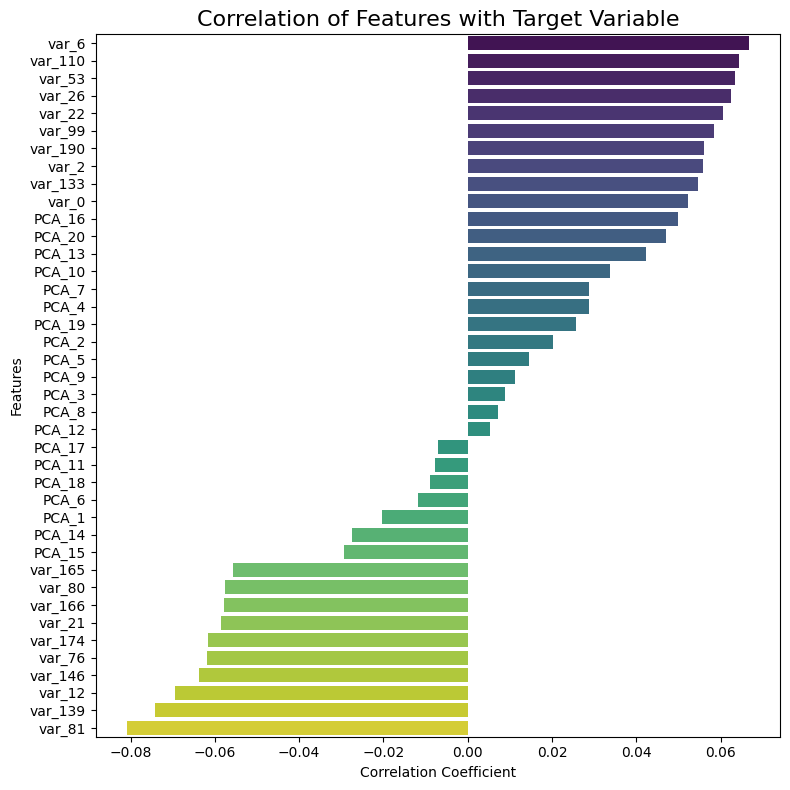

In [32]:
# Calculate correlations with the target variable
df_combined_num = df_combined.select_dtypes(include=['float64', 'int64']).drop(columns=['target'])

correlations_with_target = df_combined_num.corrwith(df_combined['target']).sort_values(ascending=False)

# Display the top and bottom correlations

print("Top 10 features most positively correlated with target:")
display(correlations_with_target.head(10))

print("\nTop 10 features most negatively correlated with target:")
display(correlations_with_target.tail(10))

# Optional: Visualize correlations with target (can be a bar plot if too many features)
plt.figure(figsize=(8, 8))
sns.barplot(x=correlations_with_target.values, y=correlations_with_target.index, palette='viridis')
plt.title('Correlation of Features with Target Variable', fontsize=16)
plt.xlabel('Correlation Coefficient')
plt.ylabel('Features')
plt.tight_layout()
plt.show()

## a new data set with feature interactions called `df_fe`

### Calculate Feature Correlations with Target
Calculate the correlation of each numerical feature (excluding 'ID_code' and 'target') with the 'target' variable.

**Reasoning**:
Calculate the correlation of each numerical feature (excluding 'ID_code' and 'target') with the 'target' variable to prepare for grouping based on correlation strength.

In [33]:
# Select numerical features excluding 'ID_code' and 'target'
# First drop 'ID_code' as it's not a numerical column
df_numeric_only = df.drop(columns=['ID_code'])
numerical_features = df_numeric_only.select_dtypes(include=np.number).drop(columns=['target'])

# Calculate correlations with the target variable
feature_correlations = numerical_features.corrwith(df['target']).sort_values(ascending=False)

# Display the correlations
display(feature_correlations)

,0
var_6,0.066731
var_110,0.064275
var_53,0.063399
var_26,0.062422
var_22,0.060558
var_99,0.058367
var_190,0.055973
var_2,0.055870
var_133,0.054548
var_0,0.052390


### Group Features by Correlation
Sort the features based on their correlation with the target and divide them into 10 equally sized groups.

**Reasoning**:
Group the features into 10 bins based on their correlation with the target, as per the plan, to prepare for generating interaction features.

In [34]:
# Sort features by correlation
sorted_features = feature_correlations.index.tolist()

# Divide features into 10 groups
n_features = len(sorted_features)
n_groups = 10
group_size = n_features // n_groups
feature_groups = [sorted_features[i * group_size:(i + 1) * group_size] for i in range(n_groups)]

# Handle any remaining features if n_features is not perfectly divisible by n_groups
if n_features % n_groups != 0:
    feature_groups[-1].extend(sorted_features[n_groups * group_size:])

# Display the first few features in each group to verify
for i, group in enumerate(feature_groups):
    print(f"Group {i+1} ({len(group)} features): {group[:5]}...")

Group 1 (20 features): ['var_6', 'var_110', 'var_53', 'var_26', 'var_22']...
Group 2 (20 features): ['var_173', 'var_164', 'var_118', 'var_147', 'var_91']...
Group 3 (20 features): ['var_49', 'var_32', 'var_130', 'var_90', 'var_24']...
Group 4 (20 features): ['var_11', 'var_82', 'var_175', 'var_144', 'var_74']...
Group 5 (20 features): ['var_19', 'var_65', 'var_3', 'var_4', 'var_189']...
Group 6 (20 features): ['var_126', 'var_38', 'var_17', 'var_30', 'var_185']...
Group 7 (20 features): ['var_182', 'var_42', 'var_101', 'var_59', 'var_152']...
Group 8 (20 features): ['var_178', 'var_45', 'var_83', 'var_88', 'var_156']...
Group 9 (20 features): ['var_188', 'var_56', 'var_93', 'var_197', 'var_87']...
Group 10 (20 features): ['var_92', 'var_149', 'var_169', 'var_44', 'var_109']...


### Generate Interaction Features
For each of the 10 groups, calculate the mean, minimum, maximum, difference (max - min), sum, and a ratio-based feature (e.g., mean / standard deviation) across the features within that group.

**Reasoning**:
Generate interaction features (mean, min, max, difference, sum, ratio) for each of the 10 feature groups to create a new set of features for the model.

In [35]:
# Create an empty DataFrame to store the new interaction features
df_fe = pd.DataFrame()

# Add 'ID_code' and 'target' from the original DataFrame
df_fe['ID_code'] = df['ID_code']
df_fe['target'] = df['target']

# Iterate through each feature group and calculate interaction features
for i, group in enumerate(feature_groups):
    group_df = df[group] # Select columns for the current group

    # Calculate interaction features for the group
    df_fe[f'group_{i+1}_mean'] = group_df.mean(axis=1)
    df_fe[f'group_{i+1}_min'] = group_df.min(axis=1)
    df_fe[f'group_{i+1}_max'] = group_df.max(axis=1)
    df_fe[f'group_{i+1}_diff'] = group_df.max(axis=1) - group_df.min(axis=1)
    df_fe[f'group_{i+1}_sum'] = group_df.sum(axis=1)

    # Calculate ratio (mean / std dev), handle division by zero
    std_dev = group_df.std(axis=1)
    df_fe[f'group_{i+1}_ratio'] = df_fe[f'group_{i+1}_mean'] / std_dev.replace(0, np.nan) # Replace 0 std dev with NaN

# Display the head and info of the new DataFrame
display(df_fe.head())
display(df_fe.info())

,ID_code,target,group_1_mean,group_1_min,group_1_max,group_1_diff,group_1_sum,group_1_ratio,group_2_mean,group_2_min,...,group_9_max,group_9_diff,group_9_sum,group_9_ratio,group_10_mean,group_10_min,group_10_max,group_10_diff,group_10_sum,group_10_ratio
0,train_0,0,5.049545,-6.7863,25.8398,32.6261,100.9909,0.579395,0.817070,-16.4727,...,20.8773,21.6111,205.0197,1.527480,10.855965,-2.3440,24.3627,26.7067,217.1193,1.588159
1,train_1,0,6.053780,-11.7684,22.5441,34.3125,121.0756,0.766221,5.055195,-11.5100,...,32.0888,45.6789,204.2471,1.070907,9.239860,-4.4223,30.2645,34.6868,184.7972,1.160608
2,train_2,0,4.352630,-13.5174,23.0866,36.6040,87.0526,0.526962,0.746740,-17.2738,...,19.4465,24.6212,141.2567,0.986306,10.646335,-1.2681,25.6820,26.9501,212.9267,1.488472
3,train_3,0,5.217865,-7.1541,23.6143,30.7684,104.3573,0.772220,1.300925,-11.0882,...,18.2366,26.4830,176.2925,1.228057,9.491335,-2.5459,17.9697,20.5156,189.8267,1.658541
4,train_4,0,5.179245,-5.5963,14.0553,19.6516,103.5849,0.970672,2.977835,-12.7047,...,23.3521,23.5029,230.7643,1.815340,10.852730,-3.6135,28.2749,31.8884,217.0546,1.397164


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 62 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   ID_code         200000 non-null  object 
 1   target          200000 non-null  int64  
 2   group_1_mean    200000 non-null  float64
 3   group_1_min     200000 non-null  float64
 4   group_1_max     200000 non-null  float64
 5   group_1_diff    200000 non-null  float64
 6   group_1_sum     200000 non-null  float64
 7   group_1_ratio   200000 non-null  float64
 8   group_2_mean    200000 non-null  float64
 9   group_2_min     200000 non-null  float64
 10  group_2_max     200000 non-null  float64
 11  group_2_diff    200000 non-null  float64
 12  group_2_sum     200000 non-null  float64
 13  group_2_ratio   200000 non-null  float64
 14  group_3_mean    200000 non-null  float64
 15  group_3_min     200000 non-null  float64
 16  group_3_max     200000 non-null  float64
 17  group_3_di

None

### Correlation of these new features with Target

Top 10 features most positively correlated with target:


,0
group_1_mean,0.190789
group_1_sum,0.190789
group_2_sum,0.133680
group_2_mean,0.133680
group_2_ratio,0.122723
group_1_ratio,0.119992
group_3_sum,0.095434
group_3_mean,0.095434
group_1_max,0.079871
group_3_ratio,0.068695



Top 10 features most negatively correlated with target:


,0
group_8_sum,-0.064242
group_8_mean,-0.064242
group_9_min,-0.086796
group_9_ratio,-0.106440
group_10_min,-0.112389
group_9_mean,-0.147615
group_9_sum,-0.147615
group_10_ratio,-0.149979
group_10_mean,-0.203353
group_10_sum,-0.203353


/tmp/ipython-input-1976462927.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=correlations_with_target.values, y=correlations_with_target.index, palette='viridis')


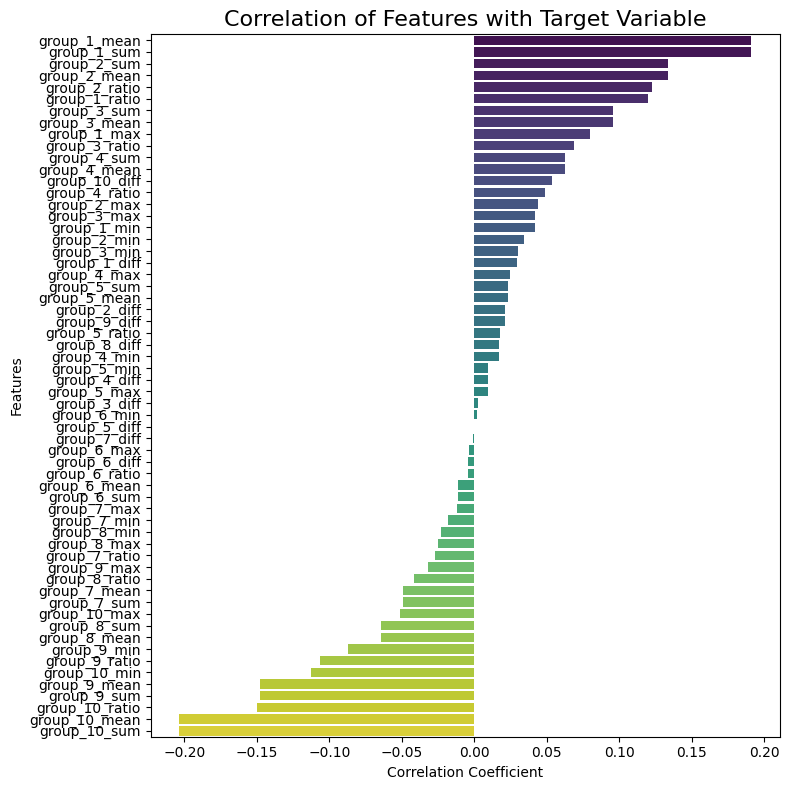

In [36]:
# Calculate correlations with the target variable
df_fe_num = df_fe.select_dtypes(include=['float64', 'int64']).drop(columns=['target'])

correlations_with_target = df_fe_num.corrwith(df_fe['target']).sort_values(ascending=False)

# Display the top and bottom correlations

print("Top 10 features most positively correlated with target:")
display(correlations_with_target.head(10))

print("\nTop 10 features most negatively correlated with target:")
display(correlations_with_target.tail(10))

# Optional: Visualize correlations with target (can be a bar plot if too many features)
plt.figure(figsize=(8, 8))
sns.barplot(x=correlations_with_target.values, y=correlations_with_target.index, palette='viridis')
plt.title('Correlation of Features with Target Variable', fontsize=16)
plt.xlabel('Correlation Coefficient')
plt.ylabel('Features')
plt.tight_layout()
plt.show()

 as we see correlation with this new features increased which is a better indication than our raw data and features previously which were weak and noisy but now it shows some pattern

## Data set including our df_fe and df_df called `df_combined_fe_df`

we will combine both df_df and df_fe just to have everything in one place and make our model decide which feature to pick and use

In [37]:
# Merge df_df and df_fe on 'ID_code'
# This will automatically handle the 'target' column as it's present in both
df_combined_fe_df = pd.merge(df_df, df_fe, on=['ID_code', 'target'], how='left')

# Display the head and info of the new combined DataFrame
display(df_combined_fe_df.head())
display(df_combined_fe_df.info())

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,group_9_max,group_9_diff,group_9_sum,group_9_ratio,group_10_mean,group_10_min,group_10_max,group_10_diff,group_10_sum,group_10_ratio
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,...,20.8773,21.6111,205.0197,1.527480,10.855965,-2.3440,24.3627,26.7067,217.1193,1.588159
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,...,32.0888,45.6789,204.2471,1.070907,9.239860,-4.4223,30.2645,34.6868,184.7972,1.160608
2,train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,...,19.4465,24.6212,141.2567,0.986306,10.646335,-1.2681,25.6820,26.9501,212.9267,1.488472
3,train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,...,18.2366,26.4830,176.2925,1.228057,9.491335,-2.5459,17.9697,20.5156,189.8267,1.658541
4,train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,...,23.3521,23.5029,230.7643,1.815340,10.852730,-3.6135,28.2749,31.8884,217.0546,1.397164


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 262 entries, ID_code to group_10_ratio
dtypes: float64(260), int64(1), object(1)
memory usage: 399.8+ MB


None

## new data set called `df_st`

we will try to make our data set standard with having same scale values for features between 0 and -1

In [38]:
from sklearn.preprocessing import MinMaxScaler
# Select numerical features excluding 'ID_code' and 'target'
numerical_features = df.select_dtypes(include=np.number).drop(columns=['ID_code', 'target'], errors='ignore')

# Initialize the MinMaxScaler to scale features between 0 and 1
scaler = MinMaxScaler(feature_range=(0, 1))

# Fit the scaler to the numerical features and transform the data
scaled_features = scaler.fit_transform(numerical_features)

# Convert the scaled features back to a DataFrame
df_scaled = pd.DataFrame(scaled_features, columns=numerical_features.columns)

# Add a small epsilon to avoid exact zeros, as requested
# Choose a very small number, e.g., 1e-9
epsilon = 1e-9
df_scaled = df_scaled + epsilon

# Combine the scaled features with 'ID_code' and 'target' from the original DataFrame
df_st = pd.concat([df[['ID_code', 'target']], df_scaled], axis=1)

# Display the head and info of the new DataFrame
display(df_st.head())
display(df_st.info())

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,0.427853,0.324824,0.568059,0.388041,0.550670,0.467321,0.454298,0.594255,...,0.569515,0.342943,0.568958,0.448173,0.510975,0.300318,0.678981,0.430958,0.327658,0.560645
1,train_1,0,0.557212,0.428639,0.681235,0.410417,0.628408,0.795072,0.536604,0.500584,...,0.668079,0.536531,0.523717,0.756190,0.350211,0.765154,0.686614,0.468277,0.609546,0.605827
2,train_2,0,0.411969,0.483777,0.578061,0.599690,0.474941,0.471329,0.753295,0.414724,...,0.522496,0.643141,0.448960,0.448000,0.671183,0.881350,0.236337,0.381950,0.425833,0.582736
3,train_3,0,0.535099,0.507140,0.396562,0.546993,0.647586,0.616822,0.572995,0.428577,...,0.570474,0.383086,0.370986,0.439205,0.745555,0.418549,0.346810,0.717176,0.590016,0.443232
4,train_4,0,0.473637,0.533434,0.624133,0.504796,0.621079,0.702836,0.589011,0.622220,...,0.387371,0.629275,0.299888,0.697737,0.238801,0.393218,0.557507,0.586526,0.591416,0.446041


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 202 entries, ID_code to var_199
dtypes: float64(200), int64(1), object(1)
memory usage: 308.2+ MB


None

## Checklist for Step 4

- ✅ checked all features being numeric

- ✅ Initial data frame copy is created as `df_df`

- ✅ Created combined PCA features with high correlation features in a data frame as `df_combined`

- ✅ Created feature engineered aggregated features for low correlation features with target in a data frame  as `df_fe`

- ✅ Standard features in a data frame is created as `df_st`

# Step 5: baseline modeling on different data frames

before we continue with modeling we need to balance our data set based on target feature

In [39]:
df["target"].value_counts()

,count
target,
0,179902
1,20098


what we can do is downsampling target 0 to 20098 to have exactly 50-50 distribution

## pipeline for downsampling and fitting

## 3 using 4 data frames we created earlier on 4 models (Logistic regression/ RandomForest/SGD Classifier and Kernel Approx + Logistic regression)

Create a pipeline that takes four dataframes (`df_df`, `df_combined`, `df_st`, `df_fe`), downsamples the target=0 class to match the target=1 class count, splits each downsampled dataframe into 80/20 train/validation sets, trains a Random Forest Classifier, Logistic Regression, SGD Classifier, and a Kernel Approximation model on each training set, evaluates each model on its corresponding validation set using Accuracy, Precision, Recall, F1-score, and ROC AUC, and finally presents the results in a comparison table.

In [56]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.kernel_approximation import RBFSampler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

# ---------- Helper Functions ----------

def evaluate_model(model, X_val, y_val):
    """
    Evaluates a trained model on validation data and returns evaluation metrics.
    """
    y_pred = model.predict(X_val)
    y_pred_proba = model.predict_proba(X_val)[:, 1] if hasattr(model, "predict_proba") else None

    accuracy = accuracy_score(y_val, y_pred)
    precision = precision_score(y_val, y_pred)
    recall = recall_score(y_val, y_pred)
    f1 = f1_score(y_val, y_pred)
    roc_auc = roc_auc_score(y_val, y_pred_proba) if y_pred_proba is not None else None

    return {
        "Accuracy": accuracy,
        "Precision": precision,
        "Recall": recall,
        "F1-score": f1,
        "ROC AUC": roc_auc
    }

def downsample_majority(df):
    """
    Downsamples the majority class (target=0) to match the minority class count (target=1).
    """
    df_majority = df[df['target'] == 0]
    df_minority = df[df['target'] == 1]
    minority_count = len(df_minority)

    df_majority_downsampled = df_majority.sample(n=minority_count, random_state=42)
    df_downsampled = pd.concat([df_majority_downsampled, df_minority])
    return df_downsampled.sample(frac=1, random_state=42).reset_index(drop=True)

# ---------- Example Datasets ----------

# Replace with your actual data
# These should be already loaded in your environment
# Example:
# df_df = pd.read_csv('...')
# df_combined = pd.read_csv('...')
# df_st = pd.read_csv('...')
# df_fe = pd.read_csv('...')

dataframes_to_process = {
    'df_df': df_df,
    'df_combined': df_combined,
    'df_st': df_st,
    'df_fe': df_fe
}

# ---------- Processing and Evaluation ----------

results_list = []

for name, current_df in dataframes_to_process.items():
    print(f"\n🔄 Processing dataset: {name}")

    # Downsample to balance classes
    df_downsampled = downsample_majority(current_df)

    # Split into X and y
    X = df_downsampled.drop(columns=['ID_code', 'target'], errors='ignore')
    y = df_downsampled['target']

    # Train/test split
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, test_size=0.2, random_state=42, stratify=y
    )

    print(f"📊  Data shape: {df_downsampled.shape}")
    print(f"📚  X_train: {X_train.shape}, X_val: {X_val.shape}")

    # Re-initialize models freshly for each dataset
    models = {
        'Random Forest': RandomForestClassifier(random_state=42),
        'Logistic Regression': LogisticRegression(random_state=42, solver='liblinear'),
        'SGD Classifier': SGDClassifier(random_state=42),
        'Kernel Approx + Logistic Regression': Pipeline([
            ('rbf_sampler', RBFSampler(n_components=100, random_state=42)),
            ('logistic_regression', LogisticRegression(random_state=42, solver='liblinear'))
        ])
    }

    # Train and evaluate each model
    for model_name, model in models.items():
        print(f"\n🚀 Training model: {model_name}")
        model.fit(X_train, y_train)

        # Evaluate
        metrics = evaluate_model(model, X_val, y_val)
        print(f"📈 Evaluation for {model_name} on {name}: {metrics}")

        # Store results
        results_list.append({
            'Dataset': name,
            'Model': model_name,
            **metrics
        })

# ---------- Final Results Table ----------

results_df = pd.DataFrame(results_list)

print("\n✅ All model evaluations complete.\n")
print("--- Model Comparison Table ---")
display(results_df)  # If using Jupyter
# print(results_df)  # Use this instead in plain Python



🔄 Processing dataset: df_df
📊  Data shape: (40196, 202)
📚  X_train: (32156, 200), X_val: (8040, 200)

🚀 Training model: Random Forest
📈 Evaluation for Random Forest on df_df: {'Accuracy': 0.743407960199005, 'Precision': 0.7352729021399375, 'Recall': 0.7606965174129353, 'F1-score': 0.7477686758772466, 'ROC AUC': np.float64(0.8224230526472118)}

🚀 Training model: Logistic Regression
📈 Evaluation for Logistic Regression on df_df: {'Accuracy': 0.7789800995024876, 'Precision': 0.7805854390793094, 'Recall': 0.7761194029850746, 'F1-score': 0.7783460147187227, 'ROC AUC': np.float64(0.8555578451028439)}

🚀 Training model: SGD Classifier
📈 Evaluation for SGD Classifier on df_df: {'Accuracy': 0.707089552238806, 'Precision': 0.6482635796972396, 'Recall': 0.9054726368159204, 'F1-score': 0.7555786196159834, 'ROC AUC': None}

🚀 Training model: Kernel Approx + Logistic Regression
📈 Evaluation for Kernel Approx + Logistic Regression on df_df: {'Accuracy': 0.49651741293532337, 'Precision': 0.4965052421

,Dataset,Model,Accuracy,Precision,Recall,F1-score,ROC AUC
0,df_df,Random Forest,0.743408,0.735273,0.760697,0.747769,0.822423
1,df_df,Logistic Regression,0.778980,0.780585,0.776119,0.778346,0.855558
2,df_df,SGD Classifier,0.707090,0.648264,0.905473,0.755579,NaN
3,df_df,Kernel Approx + Logistic Regression,0.496517,0.496505,0.494776,0.495639,0.499004
4,df_combined,Random Forest,0.698881,0.694573,0.709950,0.702177,0.762291
5,df_combined,Logistic Regression,0.687687,0.686989,0.689552,0.688268,0.753966
6,df_combined,SGD Classifier,0.625373,0.593023,0.799254,0.680865,NaN
7,df_combined,Kernel Approx + Logistic Regression,0.496269,0.496289,0.499005,0.497643,0.499777
8,df_st,Random Forest,0.743284,0.735209,0.760448,0.747616,0.822427
9,df_st,Logistic Regression,0.777861,0.779390,0.775124,0.777251,0.855635


as we can see our logistic regression is performing better than the other models
with around `0.855558` ROC AUC on `df_df` and also `0.855635` on our standard data frame `df_st`

it is also visible to us that PCA and feature engineering like mean max min median and difference and ratio of our low correlation features with target didnt help that much

no we can take our logistic regression from here and try to fine tune it later
what we also will take in to consideration is using boosting models like XGBoost, CatBoost and LighGBM

## Using baseline boosting models (XGBClassifier/LGBMClassifier/CatBoostClassifier)

In [58]:
!pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.2/99.2 MB 7.3 MB/s eta 0:00:00


In [59]:
# ✅ Boosting libraries
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

# ---------- Helper Functions ----------

def evaluate_model(model, X_val, y_val):
    """
    Evaluates a trained model on validation data and returns evaluation metrics.
    """
    y_pred = model.predict(X_val)
    y_pred_proba = model.predict_proba(X_val)[:, 1] if hasattr(model, "predict_proba") else None

    accuracy = accuracy_score(y_val, y_pred)
    precision = precision_score(y_val, y_pred)
    recall = recall_score(y_val, y_pred)
    f1 = f1_score(y_val, y_pred)
    roc_auc = roc_auc_score(y_val, y_pred_proba) if y_pred_proba is not None else None

    return {
        "Accuracy": accuracy,
        "Precision": precision,
        "Recall": recall,
        "F1-score": f1,
        "ROC AUC": roc_auc
    }

def downsample_majority(df):
    """
    Downsamples the majority class (target=0) to match the minority class count (target=1).
    """
    df_majority = df[df['target'] == 0]
    df_minority = df[df['target'] == 1]
    minority_count = len(df_minority)

    df_majority_downsampled = df_majority.sample(n=minority_count, random_state=42)
    df_downsampled = pd.concat([df_majority_downsampled, df_minority])
    return df_downsampled.sample(frac=1, random_state=42).reset_index(drop=True)

# ---------- Example Datasets ----------

dataframes_to_process = {
    'df_df': df_df,
    'df_combined': df_combined,
    'df_st': df_st,
    'df_fe': df_fe
}

# ---------- Processing and Evaluation ----------

results_list = []

for name, current_df in dataframes_to_process.items():
    print(f"\n🔄 Processing dataset: {name}")

    # Downsample to balance classes
    df_downsampled = downsample_majority(current_df)

    # Split into X and y
    X = df_downsampled.drop(columns=['ID_code', 'target'], errors='ignore')
    y = df_downsampled['target']

    # Train/test split
    X_train, X_val, y_train, y_val = train_test_split(
        X, y, test_size=0.2, random_state=42, stratify=y
    )

    print(f"📊  Data shape: {df_downsampled.shape}")
    print(f"📚  X_train: {X_train.shape}, X_val: {X_val.shape}")

    # ✅ Boosting Models Only
    models = {
        'XGBoost': XGBClassifier(n_estimators=100, learning_rate=0.1, max_depth=5,
                                 use_label_encoder=False, eval_metric='logloss', random_state=42),
        'LightGBM': LGBMClassifier(n_estimators=100, learning_rate=0.1, max_depth=5, random_state=42),
        'CatBoost': CatBoostClassifier(iterations=100, learning_rate=0.1, depth=5, verbose=0, random_state=42)
    }

    # Train and evaluate each boosting model
    for model_name, model in models.items():
        print(f"\n🚀 Training model: {model_name}")
        model.fit(X_train, y_train)

        # Evaluate
        metrics = evaluate_model(model, X_val, y_val)
        print(f"📈 Evaluation for {model_name} on {name}: {metrics}")

        # Store results
        results_list.append({
            'Dataset': name,
            'Model': model_name,
            **metrics
        })

# ---------- Final Results Table ----------

results_df = pd.DataFrame(results_list)

print("\n✅ All boosting model evaluations complete.\n")
print("--- Boosting Model Comparison Table ---")
display(results_df)  # Use in Jupyter
# print(results_df)  # Use in non-notebook environments



🔄 Processing dataset: df_df
📊  Data shape: (40196, 202)
📚  X_train: (32156, 200), X_val: (8040, 200)

🚀 Training model: XGBoost


/usr/local/lib/python3.12/dist-packages/xgboost/training.py:183: UserWarning: [08:10:28] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


📈 Evaluation for XGBoost on df_df: {'Accuracy': 0.7685323383084577, 'Precision': 0.7817802140433308, 'Recall': 0.7450248756218906, 'F1-score': 0.7629601324672016, 'ROC AUC': np.float64(0.846514442711814)}

🚀 Training model: LightGBM
[LightGBM] [Info] Number of positive: 16078, number of negative: 16078
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.063268 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 51000
[LightGBM] [Info] Number of data points in the train set: 32156, number of used features: 200
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

/usr/local/lib/python3.12/dist-packages/xgboost/training.py:183: UserWarning: [08:11:03] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


📈 Evaluation for XGBoost on df_combined: {'Accuracy': 0.7085820895522388, 'Precision': 0.7235403892295388, 'Recall': 0.6751243781094527, 'F1-score': 0.6984944022648307, 'ROC AUC': np.float64(0.7791173485804808)}

🚀 Training model: LightGBM
[LightGBM] [Info] Number of positive: 16078, number of negative: 16078
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003715 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 10200
[LightGBM] [Info] Number of data points in the train set: 32156, number of used features: 40
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further

/usr/local/lib/python3.12/dist-packages/xgboost/training.py:183: UserWarning: [08:11:07] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


📈 Evaluation for XGBoost on df_st: {'Accuracy': 0.7685323383084577, 'Precision': 0.7817802140433308, 'Recall': 0.7450248756218906, 'F1-score': 0.7629601324672016, 'ROC AUC': np.float64(0.846514442711814)}

🚀 Training model: LightGBM
[LightGBM] [Info] Number of positive: 16078, number of negative: 16078
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.104851 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 51000
[LightGBM] [Info] Number of data points in the train set: 32156, number of used features: 200
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

/usr/local/lib/python3.12/dist-packages/xgboost/training.py:183: UserWarning: [08:11:20] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


📈 Evaluation for XGBoost on df_fe: {'Accuracy': 0.7303482587064677, 'Precision': 0.7347870182555781, 'Recall': 0.7208955223880597, 'F1-score': 0.7277749874434958, 'ROC AUC': np.float64(0.8076503056855027)}

🚀 Training model: LightGBM
[LightGBM] [Info] Number of positive: 16078, number of negative: 16078
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.016305 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 15300
[LightGBM] [Info] Number of data points in the train set: 32156, number of used features: 60
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

,Dataset,Model,Accuracy,Precision,Recall,F1-score,ROC AUC
0,df_df,XGBoost,0.768532,0.781780,0.745025,0.762960,0.846514
1,df_df,LightGBM,0.766294,0.781193,0.739801,0.759934,0.846465
2,df_df,CatBoost,0.772139,0.785640,0.748507,0.766624,0.854159
3,df_combined,XGBoost,0.708582,0.723540,0.675124,0.698494,0.779117
4,df_combined,LightGBM,0.710945,0.726738,0.676119,0.700515,0.778490
5,df_combined,CatBoost,0.708955,0.722576,0.678358,0.699769,0.783064
6,df_st,XGBoost,0.768532,0.781780,0.745025,0.762960,0.846514
7,df_st,LightGBM,0.763433,0.778099,0.737065,0.757026,0.847529
8,df_st,CatBoost,0.772139,0.785640,0.748507,0.766624,0.854160
9,df_fe,XGBoost,0.730348,0.734787,0.720896,0.727775,0.807650


again its obvious our data sets called `df_combined` wont bring that much value and enhance the performance of ML in this project, so definitelly we will drop that for now
also the same for `df_fe` so we will continue with our best data set which was initially provided by kaggle called `df_df`

for our models we will pick CatBoost and from previous models we tried Logosctic regression

## RandomizedSearchCV Logistic regression and CatBoost

In [65]:
from sklearn.model_selection import RandomizedSearchCV
# ---------- Helper Functions ----------

def evaluate_model(model, X_val, y_val):
    y_pred = model.predict(X_val)
    y_pred_proba = model.predict_proba(X_val)[:, 1] if hasattr(model, "predict_proba") else None

    return {
        "Accuracy": accuracy_score(y_val, y_pred),
        "Precision": precision_score(y_val, y_pred),
        "Recall": recall_score(y_val, y_pred),
        "F1-score": f1_score(y_val, y_pred),
        "ROC AUC": roc_auc_score(y_val, y_pred_proba) if y_pred_proba is not None else None
    }

def downsample_majority(df):
    df_majority = df[df['target'] == 0]
    df_minority = df[df['target'] == 1]
    minority_count = len(df_minority)

    df_majority_downsampled = df_majority.sample(n=minority_count, random_state=42)
    df_downsampled = pd.concat([df_majority_downsampled, df_minority])
    return df_downsampled.sample(frac=1, random_state=42).reset_index(drop=True)

# ---------- Use only df_df ----------

dataframes_to_process = {
    'df_df': df_df
}

results_list = []

# ---------- Start Processing ----------

for name, current_df in dataframes_to_process.items():
    print(f"\n🔄 Processing dataset: {name}")

    # Downsample and split
    df_downsampled = downsample_majority(current_df)
    X = df_downsampled.drop(columns=['ID_code', 'target'], errors='ignore')
    y = df_downsampled['target']
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

    print(f"📊  Data shape: {df_downsampled.shape}")
    print(f"📚  X_train: {X_train.shape}, X_val: {X_val.shape}")

    # ---------- 1. CatBoost: Randomized Search (fast) ----------

    cat_params = {
        'iterations': [100, 150, 200],
        'learning_rate': [0.01, 0.05, 0.1],
        'depth': [4, 5, 6]
    }

    cat_model = CatBoostClassifier(verbose=0, random_state=42)
    cat_search = RandomizedSearchCV(
        estimator=cat_model,
        param_distributions=cat_params,
        n_iter=5,
        cv=5,
        scoring='roc_auc',
        n_jobs=-1,
        random_state=42,
        verbose=1
    )
    print("\n🔍 Running RandomizedSearchCV for CatBoost...")
    cat_search.fit(X_train, y_train)

    for i, params in enumerate(cat_search.cv_results_['params']):
        model = CatBoostClassifier(**params, verbose=0, random_state=42)
        model.fit(X_train, y_train)

        metrics = evaluate_model(model, X_val, y_val)
        print(f"📈 CatBoost Config {i+1}: {params} → {metrics}")

        results_list.append({
            'Dataset': name,
            'Model': 'CatBoost',
            'Config': str(params),
            **metrics
        })

    # ---------- 2. Logistic Regression: Randomized Search (fast) ----------

    lr_params = {
        'C': np.logspace(-2, 2, 10),
        'penalty': ['l1', 'l2'],
        'max_iter': [100, 200, 300],
        'solver': ['liblinear']
    }

    lr_model = LogisticRegression(random_state=42)
    lr_search = RandomizedSearchCV(
        estimator=lr_model,
        param_distributions=lr_params,
        n_iter=5,
        cv=5,
        scoring='roc_auc',
        n_jobs=-1,
        random_state=42,
        verbose=1
    )
    print("\n🔍 Running RandomizedSearchCV for Logistic Regression...")
    lr_search.fit(X_train, y_train)

    for i, params in enumerate(lr_search.cv_results_['params']):
        model = LogisticRegression(**params, random_state=42)
        model.fit(X_train, y_train)

        metrics = evaluate_model(model, X_val, y_val)
        print(f"📈 Logistic Regression Config {i+1}: {params} → {metrics}")

        results_list.append({
            'Dataset': name,
            'Model': 'Logistic Regression',
            'Config': str(params),
            **metrics
        })

# ---------- Final Results Table ----------

results_df = pd.DataFrame(results_list)
results_df = results_df.sort_values(by=["Model", "ROC AUC"], ascending=[True, False]).reset_index(drop=True)

print("\n✅ RandomizedSearchCV complete. Sorted results:")
display(results_df)  # For Jupyter


🔄 Processing dataset: df_df
📊  Data shape: (40196, 202)
📚  X_train: (32156, 200), X_val: (8040, 200)

🔍 Running RandomizedSearchCV for CatBoost...
Fitting 5 folds for each of 5 candidates, totalling 25 fits
📈 CatBoost Config 1: {'learning_rate': 0.1, 'iterations': 200, 'depth': 4} → {'Accuracy': 0.7859452736318407, 'Precision': 0.7966451612903226, 'Recall': 0.767910447761194, 'F1-score': 0.7820139328689044, 'ROC AUC': np.float64(0.8693032969480954)}
📈 CatBoost Config 2: {'learning_rate': 0.05, 'iterations': 150, 'depth': 5} → {'Accuracy': 0.7652985074626866, 'Precision': 0.778677815521296, 'Recall': 0.7412935323383084, 'F1-score': 0.7595259334777622, 'ROC AUC': np.float64(0.8455916313952626)}
📈 CatBoost Config 3: {'learning_rate': 0.01, 'iterations': 100, 'depth': 5} → {'Accuracy': 0.6850746268656717, 'Precision': 0.7009724473257699, 'Recall': 0.6455223880597015, 'F1-score': 0.6721056721056721, 'ROC AUC': np.float64(0.7525170169055221)}
📈 CatBoost Config 4: {'learning_rate': 0.01, 'it

,Dataset,Model,Config,Accuracy,Precision,Recall,F1-score,ROC AUC
0,df_df,CatBoost,"{'learning_rate': 0.1, 'iterations': 200, 'dep...",0.785945,0.796645,0.767910,0.782014,0.869303
1,df_df,CatBoost,"{'learning_rate': 0.05, 'iterations': 150, 'de...",0.765299,0.778678,0.741294,0.759526,0.845592
2,df_df,CatBoost,"{'learning_rate': 0.01, 'iterations': 150, 'de...",0.711692,0.727297,0.677363,0.701443,0.783664
3,df_df,CatBoost,"{'learning_rate': 0.01, 'iterations': 100, 'de...",0.685075,0.700972,0.645522,0.672106,0.752517
4,df_df,CatBoost,"{'learning_rate': 0.01, 'iterations': 100, 'de...",0.670771,0.690324,0.619403,0.652943,0.740040
5,df_df,Logistic Regression,"{'solver': 'liblinear', 'penalty': 'l1', 'max_...",0.779104,0.780921,0.775871,0.778388,0.855664
6,df_df,Logistic Regression,"{'solver': 'liblinear', 'penalty': 'l2', 'max_...",0.777612,0.779279,0.774627,0.776946,0.855412
7,df_df,Logistic Regression,"{'solver': 'liblinear', 'penalty': 'l2', 'max_...",0.777985,0.780005,0.774378,0.777181,0.855386
8,df_df,Logistic Regression,"{'solver': 'liblinear', 'penalty': 'l2', 'max_...",0.776244,0.778670,0.771891,0.775265,0.853986
9,df_df,Logistic Regression,"{'solver': 'liblinear', 'penalty': 'l1', 'max_...",0.770896,0.771978,0.768905,0.770439,0.850946


📊 **CatBoost Results**

* Best ROC AUC ≈ **0.869** (Config 1: learning\_rate=0.1, iterations=200, depth=4)
* Other configs drop quickly (0.84, 0.78, 0.74 …)
* Accuracy hovers between **0.67–0.79** depending on hyperparameters.
* The spread between configs is **quite large** → CatBoost is **sensitive to parameters** here.

👉 **Interpretation:** CatBoost can perform decently, but without careful tuning it fluctuates a lot. Its best run (0.869 ROC AUC) is solid but not as good as Logistic Regression’s best.

---

📊 **Logistic Regression Results**

* ROC AUC consistently between **0.851 – 0.856** across all 5 configs.
* Accuracy consistently \~**0.77–0.78**.
* Very **stable performance** regardless of penalty (`l1` vs `l2`) or `C` values.
* Differences between configs are minimal (within \~0.005 ROC AUC).

👉 **Interpretation:** Logistic Regression is **very consistent**, and its best run (0.856 ROC AUC) edges out CatBoost’s best (0.869 vs 0.856 → CatBoost wins *if tuned well*, but Logistic is more reliable).

---

🧠 Confidence & Stability

* **CatBoost:** Higher *potential* (best config scored better than Logistic Regression), but **less stable** and heavily parameter-dependent.
* **Logistic Regression:** Slightly lower *ceiling*, but **more consistent** and less sensitive to tuning.

If we define "confidence" as **model reliability across different parameter choices**, then:
👉 **Logistic Regression is more confident.**
👉 **CatBoost is more opportunistic** (can outperform Logistic if tuned right, but risky if not).

---

⏱️ Runtime Concern

You said Logistic Regression was *very slow* for you despite being a simple model.
Normally, Logistic Regression should be **much faster than CatBoost**. If it’s slow, likely reasons are:

* **40,000 rows × 200 features** → with `liblinear` + L1 penalty, it becomes slow (L1 is expensive).
* Switching to **L2 only** (`penalty='l2'`) would speed it up a lot.
* Alternatively, using **solver='saga'** (with L2) can scale better on large feature sets.

---

✅ Takeaway

* If you want **stability and interpretability** → stick with Logistic Regression (but use L2 to speed it up).
* If you want **higher ceiling** and can afford more careful tuning → go with CatBoost.



After we picked our best model and best hyperparameters and best data set so far we will use epoch and batches to train our model as good as we can also using callbacks and then we save the model

## GridseachCV for CatBoost

since our CatBoost is highly parameters dependant we will use GridSeachCV to see what parameters perform much better

In [66]:
from sklearn.model_selection import GridSearchCV
# ---------- Helper Functions ----------

def evaluate_model(model, X_val, y_val):
    y_pred = model.predict(X_val)
    y_pred_proba = model.predict_proba(X_val)[:, 1] if hasattr(model, "predict_proba") else None
    return {
        "Accuracy": accuracy_score(y_val, y_pred),
        "Precision": precision_score(y_val, y_pred),
        "Recall": recall_score(y_val, y_pred),
        "F1-score": f1_score(y_val, y_pred),
        "ROC AUC": roc_auc_score(y_val, y_pred_proba) if y_pred_proba is not None else None
    }

def downsample_majority(df):
    df_majority = df[df['target'] == 0]
    df_minority = df[df['target'] == 1]
    minority_count = len(df_minority)
    df_majority_downsampled = df_majority.sample(n=minority_count, random_state=42)
    df_downsampled = pd.concat([df_majority_downsampled, df_minority])
    return df_downsampled.sample(frac=1, random_state=42).reset_index(drop=True)

# ---------- Use only df_df ----------

print("\n🔄 Processing dataset: df_df")
df_downsampled = downsample_majority(df_df)

X = df_downsampled.drop(columns=['ID_code', 'target'], errors='ignore')
y = df_downsampled['target']

# Single hold-out split (so we can compute per-config metrics consistently)
X_train, X_val, y_train, y_val = train_test_split(
    X, y, test_size=0.2, stratify=y, random_state=42
)

print(f"📊 Data shape: {df_downsampled.shape}")
print(f"📚 X_train: {X_train.shape}, X_val: {X_val.shape}")

# ---------- CatBoost: Grid Search (compact & fast) ----------

# Keep grid modest to avoid long runtimes (24 combos → 120 fits with cv=5)
param_grid = {
    'iterations': [150, 250],
    'learning_rate': [0.05, 0.1],
    'depth': [4, 6],
    'l2_leaf_reg': [1, 3, 5]
}

cb_base = CatBoostClassifier(
    verbose=0,
    random_state=42,
    thread_count=-1,          # use all cores
    loss_function='Logloss',
    eval_metric='AUC'
)

print("\n🔍 Running GridSearchCV for CatBoost...")
cb_grid = GridSearchCV(
    estimator=cb_base,
    param_grid=param_grid,
    scoring='roc_auc',
    cv=5,                     # at most 5 folds (lower to 3 if too slow)
    n_jobs=-1,
    verbose=1,
    refit=False               # we'll refit each config on full train below for fair val metrics
)
cb_grid.fit(X_train, y_train)

# Evaluate each combination on the same validation split
results_list = []
print("\n📌 Evaluating every CatBoost configuration on the validation set...")

for i, params in enumerate(cb_grid.cv_results_['params']):
    print(f"  ✔️ Config {i+1}/{len(cb_grid.cv_results_['params'])}: {params}")
    model = CatBoostClassifier(
        **params,
        verbose=0,
        random_state=42,
        thread_count=-1,
        loss_function='Logloss',
        eval_metric='AUC'
    )
    model.fit(X_train, y_train)

    metrics = evaluate_model(model, X_val, y_val)
    print(f"     → {metrics}")

    results_list.append({
        'Model': 'CatBoost',
        'Config': str(params),
        **metrics
    })

# ---------- Final Results Table ----------

results_df = pd.DataFrame(results_list)
results_df = results_df.sort_values(by='ROC AUC', ascending=False).reset_index(drop=True)

print("\n✅ GridSearchCV complete. Sorted results (by ROC AUC):")
display(results_df)  # Jupyter
# print(results_df)  # Non-Jupyter



🔄 Processing dataset: df_df
📊 Data shape: (40196, 202)
📚 X_train: (32156, 200), X_val: (8040, 200)

🔍 Running GridSearchCV for CatBoost...
Fitting 5 folds for each of 24 candidates, totalling 120 fits

📌 Evaluating every CatBoost configuration on the validation set...
  ✔️ Config 1/24: {'depth': 4, 'iterations': 150, 'l2_leaf_reg': 1, 'learning_rate': 0.05}
     → {'Accuracy': 0.754726368159204, 'Precision': 0.7701846965699208, 'Recall': 0.7261194029850746, 'F1-score': 0.7475032010243278, 'ROC AUC': np.float64(0.8364365981040074)}
  ✔️ Config 2/24: {'depth': 4, 'iterations': 150, 'l2_leaf_reg': 1, 'learning_rate': 0.1}
     → {'Accuracy': 0.7756218905472637, 'Precision': 0.7886920270974466, 'Recall': 0.7529850746268657, 'F1-score': 0.7704250445405956, 'ROC AUC': np.float64(0.8603744338011435)}
  ✔️ Config 3/24: {'depth': 4, 'iterations': 150, 'l2_leaf_reg': 3, 'learning_rate': 0.05}
     → {'Accuracy': 0.7569651741293533, 'Precision': 0.7705605028810896, 'Recall': 0.7318407960199005, 

,Model,Config,Accuracy,Precision,Recall,F1-score,ROC AUC
0,CatBoost,"{'depth': 6, 'iterations': 250, 'l2_leaf_reg':...",0.796891,0.802228,0.788060,0.795081,0.879916
1,CatBoost,"{'depth': 6, 'iterations': 250, 'l2_leaf_reg':...",0.794776,0.801373,0.783831,0.792505,0.877853
2,CatBoost,"{'depth': 6, 'iterations': 250, 'l2_leaf_reg':...",0.796269,0.803208,0.784826,0.793910,0.877692
3,CatBoost,"{'depth': 4, 'iterations': 250, 'l2_leaf_reg':...",0.789677,0.799280,0.773632,0.786247,0.874523
4,CatBoost,"{'depth': 4, 'iterations': 250, 'l2_leaf_reg':...",0.788682,0.798559,0.772139,0.785127,0.874005
5,CatBoost,"{'depth': 4, 'iterations': 250, 'l2_leaf_reg':...",0.792537,0.801538,0.777612,0.789394,0.873236
6,CatBoost,"{'depth': 6, 'iterations': 150, 'l2_leaf_reg':...",0.788060,0.797075,0.772886,0.784794,0.870065
7,CatBoost,"{'depth': 6, 'iterations': 150, 'l2_leaf_reg':...",0.785821,0.795981,0.768657,0.782080,0.869698
8,CatBoost,"{'depth': 6, 'iterations': 150, 'l2_leaf_reg':...",0.787438,0.797120,0.771144,0.783917,0.869485
9,CatBoost,"{'depth': 6, 'iterations': 250, 'l2_leaf_reg':...",0.787189,0.798398,0.768408,0.783116,0.868479


as we see after tuning our model best parameters are

🏆 Best Hyperparameters Overall

If we balance all metrics together, your best choice is:

- depth = 6

- iterations = 250

- learning_rate = 0.1

- l2_leaf_reg = 5

(= Config 24)

## Train CatBoost on whole train data frame

In [72]:
from collections import Counter
from sklearn.model_selection import StratifiedKFold
# =========================
# Data (FULL, no downsampling)
# =========================
X = df_df.drop(columns=['ID_code', 'target'], errors='ignore')
y = df_df['target']

# Class weights (handle imbalance; order must match labels [0, 1])
counts = Counter(y)
total = len(y)
class_weights = [total / counts[0], total / counts[1]]
print("Class distribution:", dict(counts))
print("Class weights:", class_weights)

# =========================
# Best CatBoost hyperparameters (optimize AUC)
# =========================
best_params = dict(
    depth=6,
    iterations=250,
    learning_rate=0.1,
    l2_leaf_reg=5,
    random_state=42,
    loss_function='Logloss',
    eval_metric='AUC',          # primary metric
    class_weights=class_weights,
    verbose=0,
    thread_count=-1
)

# =========================
# 5-Fold Stratified CV (each fold ≈ 80/20)
# =========================
k = 5
skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)

fold_metrics = []
best_fold = {"fold": None, "auc": -np.inf}

print("\n🚀 Starting 5-Fold Stratified CV (Primary metric: ROC AUC)...")

for fold, (train_idx, val_idx) in enumerate(skf.split(X, y), start=1):
    X_train, X_val = X.iloc[train_idx], X.iloc[val_idx]
    y_train, y_val = y.iloc[train_idx], y.iloc[val_idx]

    model = CatBoostClassifier(**best_params)
    model.fit(
        X_train, y_train,
        eval_set=(X_val, y_val),
        early_stopping_rounds=50,   # early stop based on AUC
        use_best_model=True
    )

    # Predictions
    y_proba = model.predict_proba(X_val)[:, 1]
    y_pred  = (y_proba >= 0.5).astype(int)  # secondary, threshold-based metrics

    # Metrics
    auc  = roc_auc_score(y_val, y_proba)    # PRIMARY
    acc  = accuracy_score(y_val, y_pred)
    prec = precision_score(y_val, y_pred)
    rec  = recall_score(y_val, y_pred)
    f1   = f1_score(y_val, y_pred)

    print(f"Fold {fold}: ROC AUC={auc:.4f} | Acc={acc:.4f} | Prec={prec:.4f} | Rec={rec:.4f} | F1={f1:.4f}")

    if auc > best_fold["auc"]:
        best_fold = {"fold": fold, "auc": auc}

    fold_metrics.append({
        "Fold": fold,
        "ROC AUC": auc,          # put AUC first in the table
        "Accuracy": acc,
        "Precision": prec,
        "Recall": rec,
        "F1-score": f1
    })

# =========================
# Results table & summary (AUC-first, sorted by AUC)
# =========================
results_df = pd.DataFrame(fold_metrics).sort_values(by="ROC AUC", ascending=False).reset_index(drop=True)
summary = results_df[['ROC AUC','Accuracy','Precision','Recall','F1-score']].agg(['mean', 'std'])

print(f"\n🏅 Best fold by ROC AUC: Fold {best_fold['fold']} (AUC={best_fold['auc']:.4f})")

print("\n✅ CV Results by Fold (sorted by ROC AUC):")
print(results_df.to_string(index=False))

print("\n📊 Summary (mean ± std):")
print(summary.to_string())


Class distribution: {0: 179902, 1: 20098}
Class weights: [1.1117163789174105, 9.951238929246692]

🚀 Starting 5-Fold Stratified CV (Primary metric: ROC AUC)...
Fold 1: ROC AUC=0.8866 | Acc=0.8321 | Prec=0.3475 | Rec=0.7646 | F1=0.4778
Fold 2: ROC AUC=0.8869 | Acc=0.8320 | Prec=0.3475 | Rec=0.7654 | F1=0.4780
Fold 3: ROC AUC=0.8792 | Acc=0.8302 | Prec=0.3422 | Rec=0.7480 | F1=0.4696
Fold 4: ROC AUC=0.8865 | Acc=0.8305 | Prec=0.3459 | Rec=0.7706 | F1=0.4775
Fold 5: ROC AUC=0.8871 | Acc=0.8283 | Prec=0.3418 | Rec=0.7652 | F1=0.4725

🏅 Best fold by ROC AUC: Fold 5 (AUC=0.8871)

✅ CV Results by Fold (sorted by ROC AUC):
 Fold  ROC AUC  Accuracy  Precision   Recall  F1-score
    5 0.887060  0.828325   0.341816 0.765174  0.472540
    2 0.886924  0.832050   0.347531 0.765365  0.478011
    1 0.886606  0.832100   0.347507 0.764618  0.477842
    4 0.886523  0.830500   0.345913 0.770647  0.477497
    3 0.879185  0.830200   0.342249 0.748010  0.469624

📊 Summary (mean ± std):
       ROC AUC  Accurac

In [73]:
df_test = read_csv("/content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data/test.csv")

our data set is successfully imported from path: /content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data/test.csv

our data set has the shape of: 

(200000, 201)
our data set has also the info as: 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 201 entries, ID_code to var_199
dtypes: float64(200), object(1)
memory usage: 306.7+ MB
None
10 first rows in our data set are: 

  ID_code    var_0    var_1    var_2   var_3    var_4    var_5   var_6  \
0  test_0  11.0656   7.7798  12.9536  9.4292  11.4327  -2.3805  5.8493   
1  test_1   8.5304   1.2543  11.3047  5.1858   9.1974  -4.0117  6.0196   
2  test_2   5.4827 -10.3581  10.1407  7.0479  10.2628   9.8052  4.8950   
3  test_3   8.5374  -1.3222  12.0220  6.5749   8.8458   3.1744  4.9397   
4  test_4  11.7058  -0.1327  14.1295  7.7506   9.1035  -8.5848  6.8595   
5  test_5   5.9862  -2.2913   8.6058  7.0685  14.2465  -8.6761  4.2467   
6  test_6   8.4624  -6.1065   7.3603  8.

In [75]:
import os
import numpy as np
import pandas as pd
from collections import Counter
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve
from catboost import CatBoostClassifier

# (Colab only) Mount Google Drive if not mounted
# from google.colab import drive
# drive.mount('/content/drive')

SAVE_DIR = "/content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data"
os.makedirs(SAVE_DIR, exist_ok=True)

# ---- Train data (full df_df; no downsampling) ----
X = df_df.drop(columns=['ID_code', 'target'], errors='ignore')
y = df_df['target']

# ---- Test data ----
X_test = df_test.drop(columns=['ID_code'], errors='ignore')
X_test = X_test[X.columns]  # align columns/order

# ---- Class weights for imbalance ----
counts = Counter(y)
total = len(y)
class_weights = [total / counts[0], total / counts[1]]

# ---- Best CatBoost hyperparameters ----
best_params = dict(
    depth=6,
    iterations=250,
    learning_rate=0.1,
    l2_leaf_reg=5,
    random_state=42,
    loss_function='Logloss',
    eval_metric='AUC',
    class_weights=class_weights,
    verbose=100,
    thread_count=-1
)

# ---- Small holdout for early stopping & optional threshold tuning ----
X_tr, X_es, y_tr, y_es = train_test_split(
    X, y, test_size=0.10, stratify=y, random_state=42
)

model = CatBoostClassifier(**best_params)
model.fit(
    X_tr, y_tr,
    eval_set=(X_es, y_es),
    early_stopping_rounds=50,
    use_best_model=True
)

# ---- Predict on test: probabilities (recommended for ROC AUC submissions) ----
test_proba = model.predict_proba(X_test)[:, 1]
sub_proba = pd.DataFrame({
    'ID_code': df_test['ID_code'],
    'target': test_proba
})
proba_path = os.path.join(SAVE_DIR, "submission_proba.csv")
sub_proba.to_csv(proba_path, index=False)
print("Saved probability submission ->", proba_path)

# ---- Optional: binary submission using F1-tuned threshold from holdout ----
es_proba = model.predict_proba(X_es)[:, 1]
prec, rec, thr = precision_recall_curve(y_es, es_proba)
f1 = 2 * (prec[:-1] * rec[:-1]) / (prec[:-1] + rec[:-1] + 1e-12)
best_thr = float(thr[np.argmax(f1)])
print(f"Chosen threshold for binary predictions (max F1 on holdout): {best_thr:.4f}")

test_pred_bin = (test_proba >= best_thr).astype(int)
sub_bin = pd.DataFrame({
    'ID_code': df_test['ID_code'],
    'target': test_pred_bin
})
bin_path = os.path.join(SAVE_DIR, "submission_binary.csv")
sub_bin.to_csv(bin_path, index=False)
print("Saved binary submission ->", bin_path)


0:	test: 0.6300528	best: 0.6300528 (0)	total: 252ms	remaining: 1m 2s
100:	test: 0.8537467	best: 0.8537467 (100)	total: 19.3s	remaining: 28.5s
200:	test: 0.8758111	best: 0.8758111 (200)	total: 33.6s	remaining: 8.19s
249:	test: 0.8792282	best: 0.8792282 (249)	total: 40.1s	remaining: 0us

bestTest = 0.8792281505
bestIteration = 249

Saved probability submission -> /content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data/submission_proba.csv
Chosen threshold for binary predictions (max F1 on holdout): 0.6334
Saved binary submission -> /content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data/submission_binary.csv


## we just submit our test prediction to see what score we get

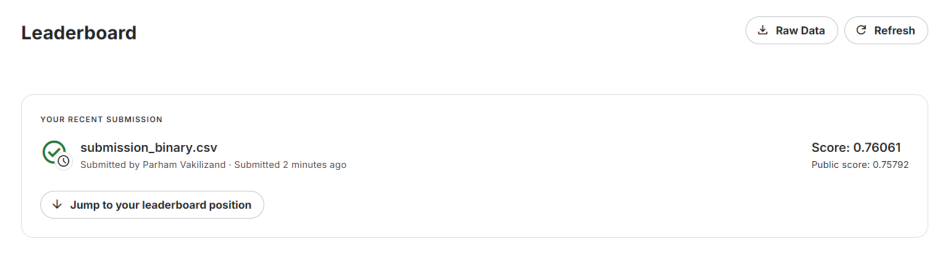

In [77]:
show_png("/content/drive/MyDrive/ML Projects/Santander-Customer-Transaction-Prediction/data/score.PNG",12,20)